<a href="https://colab.research.google.com/github/uttar07/VSL-/blob/main/train_yolov12_object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Check GPU availability

**NOTE:** **YOLOv12 leverages FlashAttention to speed up attention-based computations, but this feature requires an Nvidia GPU built on the Ampere architecture or newer—for example, GPUs like the RTX 3090, RTX 3080, or even the Nvidia L4 meet this requirement.**

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [ ]:
!nvidia-smi

Tue Dec 23 10:44:37 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   56C    P8             11W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


### Install dependencies

**NOTE:** Currently, YOLOv12 does not have its own PyPI package, so we install it directly from GitHub while also adding roboflow (to conveniently pull datasets from the Roboflow Universe), supervision (to visualize inference results and benchmark the model’s performance), and flash-attn (to accelerate attention-based computations via optimized CUDA kernels).

In [ ]:
!pip install -q git+https://github.com/sunsmarterjie/yolov12.git roboflow supervision flash-attn

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 100.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 19.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.4/212.4 kB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 80.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 117.4 MB/s eta 0:00:00


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="wt619JarRfICyjoamgtz")
project = rf.workspace("prism-zhxxq").project("people-4wxxx")
version = project.version(1)
dataset = version.download("yolov12")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to people-1 in yolov12:: 100%|██████████| 1644/1644 [00:00<00:00, 7770.59it/s]


In [ ]:
!ls /content


people-1  sample_data


In [ ]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/people-1/data.yaml', epochs=100,imgsz=640,batch=8,name="people-1")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/yolov12/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
New https://pypi.org/project/ultralytics/8.3.223 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.63 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov12s.yaml, data=/content/people-1/data.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=people-1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=T

100%|██████████| 755k/755k [00:00<00:00, 24.1MB/s]


In [ ]:
model.val()

Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/vehicle-1/valid/labels.cache... 204 images, 0 backgrounds, 0 corrupt: 100%|██████████| 204/204 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:04<00:00,  5.27it/s]


                   all        204        319        0.8      0.442      0.553      0.351
               bicycle         75        122      0.865       0.59      0.707      0.429
                   bus          9         21      0.622      0.286      0.418      0.289
                   cab          1          1          1          0      0.166      0.133
                   car         93        123      0.842      0.699      0.759      0.456
        doubledekerbus          1          1          1          0      0.497      0.348
                 lorry         22         46      0.838      0.522      0.674      0.352
                   suv          5          5      0.436          1      0.648      0.452
Speed: 0.5ms preprocess, 15.7ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/vehicle-14


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 6, 8])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d180a66c620>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
  

In [ ]:
model.predict(source="/content/people-1/valid/images", save=True,conf=0.5)

FileNotFoundError: /content/people-1/valid/images does not exist

In [ ]:
!pip install Ipython

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 35.4 MB/s eta 0:00:00


In [ ]:
!ls /content/runs/detect

In [ ]:
!ls /content/runs/detect/people-123

In [ ]:
from IPython.display import Image, display
import glob
for image_path in sorted(glob.glob('/content/runs/detect/people-123 /*.jpg'))[:10]:
  display(Image(filename=image_path))

In [ ]:
!pip install Ipython

In [ ]:
from IPython.display import Image, display
import glob
for image_path in sorted(glob.glob('/content/runs/detect/people-123/*.jpg'))[:10]:
  display(Image(filename=image_path))

In [ ]:
from IPython.display import Image, display
display(Image(filename='/content/runs/detect/people-12/results.png'))

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/train3/weights/best.pt data=/content/people-1/data.yaml

In [ ]:
!ls /content/runs/detect/

In [ ]:
!ls /content/runs/detect/people-123

In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/people-12/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

# Step 2: Get the output video file
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 3: Display the video in Colab
    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

In [ ]:
!yolo task=detect mode=predict \
     model=/content/runs/detect/train3/weights/best.pt \
     source="/content/1.mp4" \
     save=True \
     save_video=True

In [ ]:
!ls -l /content/runs/detect/predict

In [ ]:
# 1️⃣ Convert AVI to MP4
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

!ffmpeg -y -i "{output_folder}/1 (2).avi" \
-c:v libx264 -pix_fmt yuv420p "{output_folder}/annotated_video.mp4"

# 2️⃣ Play the converted MP4 inline
from IPython.display import HTML
from base64 import b64encode

video_path = f"{output_folder}/annotated_video.mp4"
mp4 = open(video_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=640 controls>
      <source src="{data_url}" type="video/mp4">
</video>
""")

In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/people-12/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

# Step 2: Get the output video file
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 3: Display the video in Colab
    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

In [ ]:
!yolo task=detect mode=predict \
     model=/content/runs/detect/train3/weights/best.pt \
     source="/content/2.mp4" \
     save=True \
     save_video=True

In [ ]:
# 1️⃣ Convert AVI to MP4
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict2*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

!ffmpeg -y -i "{output_folder}/2.avi" \
-c:v libx264 -pix_fmt yuv420p "{output_folder}/annotated_video.mp4"

# 2️⃣ Play the converted MP4 inline
from IPython.display import HTML
from base64 import b64encode

video_path = f"{output_folder}/annotated_video.mp4"
mp4 = open(video_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=640 controls>
      <source src="{data_url}" type="video/mp4">
</video>
""")

In [ ]:
# ---------------------------------------------
# YOLO Pothole Project Backup Script for Colab
# ---------------------------------------------

from google.colab import drive
import os
import shutil
import datetime

# 1️⃣ Mount Google Drive
drive.mount('/content/drive')

# 2️⃣ Define paths
project_name = "people-1"
timestamp = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
src_project_folder = "/content/people-1"  # Your current project folder
dest_drive_folder = f"/content/drive/MyDrive/{project_name}_{timestamp}"

# 3️⃣ Copy project folder to Drive
if os.path.exists(src_project_folder):
    shutil.copytree(src_project_folder, dest_drive_folder)
    print(f"✅ Project folder backed up to: {dest_drive_folder}")
else:
    print(f"❌ Source project folder not found: {src_project_folder}")

# 4️⃣ Backup YOLO trained weights
weights_src = "/content/runs/detect/train/weights/best.pt"
weights_dest = os.path.join(dest_drive_folder, "best.pt")
if os.path.exists(weights_src):
    shutil.copy2(weights_src, weights_dest)
    print(f"✅ Trained weights backed up to: {weights_dest}")
else:
    print(f"❌ Weights not found: {weights_src}")

# 5️⃣ Backup prediction results
predict_folder = "/content/runs/detect/predict2"  # Change if different
predict_dest = os.path.join(dest_drive_folder, "predict_results")
if os.path.exists(predict_folder):
    shutil.copytree(predict_folder, predict_dest)
    print(f"✅ Prediction results backed up to: {predict_dest}")
else:
    print(f"❌ Prediction results not found: {predict_folder}")

# 6️⃣ Optional: Backup notebook file
# Replace with your actual notebook filename
notebook_file = "/content/people-1.ipynb"
if os.path.exists(notebook_file):
    shutil.copy2(notebook_file, dest_drive_folder)
    print(f"✅ Notebook backed up to: {dest_drive_folder}")
else:
    print(f"❌ Notebook not found: {notebook_file}")

print("🎉 Backup complete! Everything is saved to Google Drive.")

In [ ]:
import os, shutil, glob

# === 1️⃣ Set Google Drive destination folder ===
dest_drive_folder = "/content/drive/MyDrive/YOLO_Backup"
os.makedirs(dest_drive_folder, exist_ok=True)

# === 2️⃣ Find the latest training folder (contains weights/best.pt) ===
train_folders = sorted(glob.glob('/content/runs/detect/*'), key=os.path.getmtime)
latest_train_folder = None

for folder in reversed(train_folders):
    if os.path.exists(os.path.join(folder, 'weights', 'best.pt')):
        latest_train_folder = folder
        break

if latest_train_folder:
    weights_src = os.path.join(latest_train_folder, 'weights', 'best.pt')
    weights_dest = os.path.join(dest_drive_folder, 'best.pt')
    shutil.copy2(weights_src, weights_dest)
    print(f"✅ Found model in: {latest_train_folder}")
    print(f"✅ Trained weights backed up to: {weights_dest}")
else:
    print("❌ No trained model with best.pt found in /runs/detect/")

# === 3️⃣ Find latest prediction folder ===
predict_folders = [f for f in train_folders if 'predict' in f]
if predict_folders:
    latest_predict_folder = max(predict_folders, key=os.path.getmtime)
    predict_dest = os.path.join(dest_drive_folder, 'predict_results')
    shutil.copytree(latest_predict_folder, predict_dest, dirs_exist_ok=True)
    print(f"✅ Prediction results backed up from: {latest_predict_folder}")
    print(f"✅ Saved to: {predict_dest}")
else:
    print("❌ No prediction folder found.")

# === 4️⃣ Backup the current notebook (if any) ===
notebooks = glob.glob('/content/*.ipynb')
if notebooks:
    latest_notebook = max(notebooks, key=os.path.getmtime)
    shutil.copy2(latest_notebook, dest_drive_folder)
    print(f"✅ Notebook backed up: {os.path.basename(latest_notebook)}")
else:
    print("❌ No notebook found in /content/")



In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="s0M8kaAsIRpucRuX7uTk")
project = rf.workspace("kushan-gunarathne-6etxh").project("vehicle-8hsrx")
version = project.version(1)
dataset = version.download("yolov12")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to vehicle-1 in yolov12:: 100%|██████████| 2034/2034 [00:00<00:00, 6254.80it/s]


In [ ]:
!ls /content

sample_data  vehicle-1


In [ ]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/vehicle-1/data.yaml', epochs=100,imgsz=640,batch=8,name="vehicle-1")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/yolov12/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
New https://pypi.org/project/ultralytics/8.3.211 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov12s.yaml, data=/content/vehicle-1/data.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=vehicle-1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp

100%|██████████| 755k/755k [00:00<00:00, 23.2MB/s]


Overriding model.yaml nc=80 with nc=11

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1      9344  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2, 1, 2]          
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1     37120  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2, 1, 4]        
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  2    677120  ultralytics.nn.modules.block.A2C2f           [256, 256, 2, True, 4]        
  7                  -1  1   1180672  ultralytic

100%|██████████| 5.26M/5.26M [00:00<00:00, 115MB/s]


AMP: checks passed ✅


train: Scanning /content/vehicle-1/train/labels... 709 images, 0 backgrounds, 0 corrupt: 100%|██████████| 709/709 [00:00<00:00, 2486.59it/s]


train: New cache created: /content/vehicle-1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression
val: Scanning /content/vehicle-1/valid/labels... 204 images, 0 backgrounds, 0 corrupt: 100%|██████████| 204/204 [00:00<00:00, 1696.59it/s]

val: New cache created: /content/vehicle-1/valid/labels.cache


Plotting labels to runs/detect/vehicle-1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000667, momentum=0.9) with parameter groups 121 weight(decay=0.0), 128 weight(decay=0.0005), 127 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/vehicle-1
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.74G      3.363      4.951      4.286          9        640: 100%|██████████| 89/89 [00:50<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:10<00:00,  1.20it/s]

                   all        204        319   0.000968      0.217   0.000838   0.000253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100       3.7G      3.229      4.745      4.147         32        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.298    0.00427     0.0084    0.00241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100       3.7G      3.223      4.486      3.942         11        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.54it/s]


                   all        204        319      0.431     0.0459    0.00159     0.0004

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      3.68G       2.99      4.239      3.689          9        640: 100%|██████████| 89/89 [00:26<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.33it/s]


                   all        204        319      0.434     0.0846    0.00306   0.000781

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100       3.7G      2.926      4.041      3.465         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.78it/s]


                   all        204        319     0.0126     0.0323     0.0122    0.00281

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       3.7G      2.866      3.934      3.354          7        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.79it/s]


                   all        204        319     0.0355     0.0735     0.0245    0.00589

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.68G      2.793      3.721      3.271         11        640: 100%|██████████| 89/89 [00:26<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.64it/s]


                   all        204        319      0.571     0.0395     0.0471     0.0112

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      3.74G      2.718       3.68      3.196         21        640: 100%|██████████| 89/89 [00:25<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.99it/s]


                   all        204        319      0.302      0.108     0.0784     0.0188

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      3.68G      2.657       3.46      3.107         13        640: 100%|██████████| 89/89 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.94it/s]


                   all        204        319       0.37      0.103     0.0916     0.0294

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      3.68G       2.55      3.358      2.984         12        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.61it/s]


                   all        204        319      0.203      0.141     0.0909     0.0251

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100       3.7G      2.486      3.206      2.948          9        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.275      0.147      0.119     0.0486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       3.7G      2.414      3.161      2.883         15        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.04it/s]

                   all        204        319      0.269      0.132     0.0988     0.0362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       3.7G       2.36      3.123      2.817         13        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.11it/s]

                   all        204        319      0.379      0.198      0.185     0.0756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       3.7G      2.292      3.012      2.762         13        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319       0.33      0.234      0.201      0.092



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      3.68G      2.256      2.927      2.707          7        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.00it/s]

                   all        204        319      0.455      0.215      0.204      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      3.75G      2.239      2.879      2.694         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  3.98it/s]

                   all        204        319      0.301      0.241       0.17     0.0686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      3.68G      2.197       2.84      2.652         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.01it/s]


                   all        204        319      0.356      0.301      0.233        0.1

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       3.7G      2.149       2.76      2.601         11        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.97it/s]


                   all        204        319      0.484      0.274      0.208     0.0948

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      3.67G      2.148      2.777      2.587          9        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.25it/s]

                   all        204        319      0.477      0.259      0.204     0.0861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       3.7G      2.077      2.646       2.52         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.98it/s]

                   all        204        319      0.404      0.267      0.278      0.121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      3.69G      2.053      2.611       2.49         25        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.698      0.279      0.267      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       3.7G       2.05      2.502      2.492         22        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.24it/s]

                   all        204        319      0.388      0.317      0.271      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       3.7G      2.005      2.461      2.428         11        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.606      0.293      0.301      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      3.72G      2.009      2.486      2.427         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.602      0.223      0.301      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       3.7G      1.965      2.462      2.418          9        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.47it/s]

                   all        204        319      0.519      0.329      0.327       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      3.69G      1.963      2.422      2.391         19        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.05it/s]

                   all        204        319      0.513      0.316      0.292      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      3.68G      1.982      2.408      2.393         10        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.00it/s]

                   all        204        319      0.541      0.355      0.275      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       3.7G       1.89      2.342      2.312         14        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.67it/s]

                   all        204        319        0.7      0.333      0.306      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       3.7G      1.917      2.332      2.359         11        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.98it/s]

                   all        204        319      0.587      0.345      0.468      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       3.7G      1.905      2.348      2.346         19        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.03it/s]

                   all        204        319      0.707      0.287      0.277      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100       3.7G      1.904      2.354      2.338         17        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.93it/s]


                   all        204        319      0.528      0.321      0.296      0.153

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      3.66G      1.865       2.26      2.297         16        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.92it/s]

                   all        204        319      0.564      0.347      0.316      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100       3.7G       1.81      2.199      2.256         24        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.419      0.349       0.33      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       3.7G      1.846      2.227       2.26         19        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.00it/s]


                   all        204        319      0.626      0.308      0.362      0.199

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       3.7G      1.814      2.224      2.263         12        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.42it/s]

                   all        204        319      0.455      0.552       0.39        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       3.7G       1.79      2.107      2.211         28        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]

                   all        204        319       0.37      0.453      0.322      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.69G      1.816      2.188      2.249         21        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.583      0.365      0.313      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       3.7G      1.814      2.171      2.219         14        640: 100%|██████████| 89/89 [00:26<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.55it/s]

                   all        204        319      0.776      0.332      0.334      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.69G      1.807      2.132       2.21         20        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.04it/s]

                   all        204        319      0.582       0.38      0.352      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.73G      1.754      2.087      2.202         12        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.06it/s]

                   all        204        319      0.556        0.4      0.357      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       3.7G      1.778       2.12        2.2          9        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.51it/s]

                   all        204        319      0.404      0.536       0.37       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      3.69G      1.746      2.088      2.208         23        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.06it/s]

                   all        204        319      0.411      0.513      0.372        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100       3.7G      1.753      2.069      2.168         19        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.05it/s]

                   all        204        319      0.404       0.49       0.38      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      3.68G      1.751      2.009       2.18         12        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.21it/s]

                   all        204        319      0.634      0.354      0.346      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.67G      1.741      1.994      2.157         26        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.05it/s]

                   all        204        319      0.615      0.354      0.349      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       3.7G      1.734      1.997      2.165         16        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.584      0.359      0.363      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       3.7G      1.669      1.986      2.102         14        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.28it/s]

                   all        204        319      0.467      0.392      0.376      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      3.74G      1.703       1.96      2.119         20        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.05it/s]


                   all        204        319      0.467       0.36      0.346      0.199

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.68G      1.705      1.963      2.108         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.741      0.391      0.377      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      3.69G      1.705       1.95      2.131         10        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.51it/s]


                   all        204        319      0.492      0.402      0.392      0.235

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.67G      1.713      1.961      2.125         21        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.06it/s]

                   all        204        319      0.808      0.363       0.39      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100       3.7G      1.633      1.844      2.063         21        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.06it/s]

                   all        204        319      0.693      0.416      0.407      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100       3.7G      1.677      1.893       2.08         12        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.38it/s]

                   all        204        319      0.468      0.538      0.422      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      3.67G      1.626      1.849      2.062         16        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]

                   all        204        319      0.484       0.53      0.448      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100       3.7G       1.61       1.88      2.038         18        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.538      0.535      0.419      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      3.74G      1.655       1.87      2.062         26        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.65it/s]


                   all        204        319      0.546      0.369      0.423      0.256

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100       3.7G       1.62      1.848      2.034         13        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.589      0.379      0.426      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       3.7G      1.593      1.807       2.02         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.644      0.412      0.447      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.69G      1.646      1.821      2.083         22        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]


                   all        204        319      0.712      0.369      0.397      0.231

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       3.7G      1.611      1.799      2.025         14        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.52it/s]

                   all        204        319      0.514       0.39      0.414      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.69G      1.582      1.753      1.992         20        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.749      0.376      0.443      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       3.7G        1.6      1.796      2.023         19        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]

                   all        204        319        0.7      0.387      0.393      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100       3.7G      1.582      1.758      2.012         17        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.28it/s]

                   all        204        319      0.707      0.427      0.469      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.75G      1.586      1.761      2.024         16        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.824      0.372      0.437      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.68G       1.58      1.756      1.989          9        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]

                   all        204        319       0.51      0.386      0.455      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.69G      1.543      1.728      1.962         18        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.25it/s]

                   all        204        319      0.596      0.377      0.425      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      3.67G      1.599      1.764      2.024          8        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.579      0.401      0.458      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100       3.7G       1.56      1.703      1.973         13        640: 100%|██████████| 89/89 [00:25<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.707      0.423      0.441      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.69G      1.537      1.691      1.977          8        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.29it/s]

                   all        204        319      0.688      0.407      0.448      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       3.7G      1.524      1.671      1.975         21        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.12it/s]

                   all        204        319      0.787       0.39      0.408      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100       3.7G      1.518       1.68      1.961         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.12it/s]

                   all        204        319      0.709       0.42      0.449      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.75G      1.523      1.674      1.952         16        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.56it/s]

                   all        204        319      0.748      0.404      0.476      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.68G      1.511      1.655       1.94         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.12it/s]

                   all        204        319      0.719      0.408      0.443      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       3.7G      1.527      1.674      1.953         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.12it/s]

                   all        204        319      0.491      0.581      0.459      0.276



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.67G      1.495      1.616      1.945         11        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.73it/s]

                   all        204        319       0.53      0.585       0.45      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       3.7G      1.457      1.591      1.889         18        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.537      0.457      0.478      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100       3.7G      1.497      1.602      1.912         17        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]

                   all        204        319      0.497      0.542      0.501      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       3.7G      1.523      1.616      1.931         18        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.77it/s]

                   all        204        319      0.555      0.447       0.47      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       3.7G      1.494      1.649      1.933         14        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.07it/s]

                   all        204        319      0.528      0.469      0.482      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.75G      1.504      1.575      1.914         14        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.06it/s]

                   all        204        319      0.612       0.44      0.491      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.68G      1.467      1.567      1.908         10        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.80it/s]


                   all        204        319       0.78      0.421       0.48      0.295

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      3.69G      1.486      1.553      1.924         10        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.85it/s]

                   all        204        319      0.581      0.447      0.473      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      3.67G      1.468      1.571      1.905          7        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.12it/s]

                   all        204        319      0.752      0.425      0.456      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       3.7G      1.405      1.546      1.868         14        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.577      0.451      0.474      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100       3.7G      1.432       1.52      1.878         19        640: 100%|██████████| 89/89 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.56it/s]

                   all        204        319       0.82      0.419      0.494      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       3.7G      1.428      1.484       1.85         13        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.774      0.432      0.507      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      3.69G      1.435      1.507       1.87          9        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.15it/s]

                   all        204        319      0.763      0.439      0.473      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      3.75G      1.411      1.507      1.847         10        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.25it/s]

                   all        204        319      0.762      0.439      0.503      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.68G      1.449      1.535      1.885          8        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.09it/s]

                   all        204        319      0.801      0.426       0.51      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      3.69G      1.418       1.49       1.85         18        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.12it/s]

                   all        204        319      0.781       0.42      0.481      0.304


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      3.67G      1.356      1.392      1.864          5        640: 100%|██████████| 89/89 [00:27<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.24it/s]


                   all        204        319      0.752      0.446       0.45      0.281

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       3.7G      1.343      1.341      1.855         13        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.05it/s]

                   all        204        319      0.784      0.387       0.52      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      3.69G      1.316      1.311      1.836          8        640: 100%|██████████| 89/89 [00:26<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.13it/s]

                   all        204        319      0.742      0.444      0.473      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       3.7G      1.309      1.302      1.843          6        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  4.22it/s]

                   all        204        319      0.748       0.46      0.505      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      3.69G      1.292      1.256      1.803          7        640: 100%|██████████| 89/89 [00:26<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.11it/s]

                   all        204        319      0.754      0.466      0.501      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      3.74G       1.29      1.266      1.797          8        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.08it/s]

                   all        204        319      0.719      0.472      0.499      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      3.67G      1.282      1.239      1.813          5        640: 100%|██████████| 89/89 [00:25<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.71it/s]


                   all        204        319      0.814      0.436      0.519      0.328

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100       3.7G      1.291      1.248      1.804         12        640: 100%|██████████| 89/89 [00:25<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.91it/s]

                   all        204        319      0.807      0.442      0.563      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      3.67G       1.28      1.225      1.808          6        640: 100%|██████████| 89/89 [00:25<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  5.04it/s]

                   all        204        319      0.785      0.449      0.529      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       3.7G      1.276      1.232      1.793         23        640: 100%|██████████| 89/89 [00:26<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:02<00:00,  4.93it/s]

                   all        204        319      0.821      0.434      0.552      0.354



100 epochs completed in 0.838 hours.
Optimizer stripped from runs/detect/vehicle-1/weights/last.pt, 18.7MB
Optimizer stripped from runs/detect/vehicle-1/weights/best.pt, 18.7MB

Validating runs/detect/vehicle-1/weights/best.pt...
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,078,465 parameters, 0 gradients, 19.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [00:03<00:00,  3.51it/s]


                   all        204        319      0.801      0.442      0.552      0.351
               bicycle         75        122      0.866       0.59      0.706      0.429
                   bus          9         21      0.625      0.286      0.418      0.289
                   cab          1          1          1          0      0.166      0.133
                   car         93        123      0.842      0.699      0.759      0.454
        doubledekerbus          1          1          1          0      0.497      0.348
                 lorry         22         46      0.838      0.522      0.673       0.35
                   suv          5          5      0.436          1      0.648      0.452
Speed: 0.3ms preprocess, 10.2ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/vehicle-1


In [ ]:
model.val()

Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,078,465 parameters, 0 gradients, 19.3 GFLOPs


val: Scanning /content/vehicle-1/valid/labels.cache... 204 images, 0 backgrounds, 0 corrupt: 100%|██████████| 204/204 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 26/26 [00:04<00:00,  5.47it/s]


                   all        204        319        0.8      0.442      0.553      0.351
               bicycle         75        122      0.865       0.59      0.707      0.429
                   bus          9         21      0.622      0.286      0.418      0.289
                   cab          1          1          1          0      0.166      0.133
                   car         93        123      0.842      0.699      0.759      0.456
        doubledekerbus          1          1          1          0      0.497      0.348
                 lorry         22         46      0.838      0.522      0.674      0.352
                   suv          5          5      0.436          1      0.648      0.452
Speed: 0.5ms preprocess, 15.5ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/vehicle-12


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 6, 8])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d1807e84350>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
  

In [ ]:
model.predict(source="/content/vehicle-1/valid/images", save=True,conf=0.5)


image 1/204 /content/vehicle-1/valid/images/157817546-refrigerated-semi-trailer-truck-driving-on-a-highway-under-a-dramatic-sunset-sky-_jpg.rf.3ca0772d734f2cd86eade62bbad9cfb2.jpg: 640x640 1 lorry, 22.4ms
image 2/204 /content/vehicle-1/valid/images/220px-Hume_Freeway_Craigieburn_Bypass--1-_jpg.rf.83a52bf1dd59c175475aaecd106f438d.jpg: 640x640 1 car, 1 lorry, 22.4ms
image 3/204 /content/vehicle-1/valid/images/2a524f0_jpg.rf.d19a490bb896e68c86a6590f3ce09458.jpg: 640x640 1 lorry, 22.4ms
image 4/204 /content/vehicle-1/valid/images/316733366_jpg.rf.1afcd28b9680057478efd8ca62f04e43.jpg: 640x640 1 lorry, 22.5ms
image 5/204 /content/vehicle-1/valid/images/62720488-chiangmai-thailand-august-18-2016-private-old-isuzu-dump-truck-on-road-no-1001-8-km-from-chiangmai-c_jpg.rf.bfa8e144004d0f8834f07fbce4517b3a.jpg: 640x640 1 lorry, 17.4ms
image 6/204 /content/vehicle-1/valid/images/8235260274ce89a3461ce7f78c837f1f-jpg-crdownload_jpg.rf.ae288d31ea3d8fafa1485ac86b698d87.jpg: 640x640 (no detections), 17.

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'bicycle', 1: 'bus', 2: 'cab', 3: 'car', 4: 'doubledekerbus', 5: 'jeep', 6: 'lorry', 7: 'moterbike', 8: 'suv', 9: 'threeweel', 10: 'van'}
 obb: None
 orig_img: array([[[141, 106,  96],
         [141, 106,  96],
         [141, 106,  96],
         ...,
         [150, 116, 110],
         [149, 115, 109],
         [149, 115, 109]],
 
        [[141, 106,  96],
         [141, 106,  96],
         [141, 106,  96],
         ...,
         [150, 116, 110],
         [149, 115, 109],
         [149, 115, 109]],
 
        [[141, 106,  96],
         [141, 106,  96],
         [141, 106,  96],
         ...,
         [150, 116, 110],
         [149, 115, 109],
         [149, 115, 109]],
 
        ...,
 
        [[ 33,  33,  33],
         [ 24,  24,  24],
         [ 21,  21,  21],
         ...,
         [ 52,  46,  51],
         [ 50,  44,  49],
         [ 

In [ ]:
!ls /content/runs/detect

vehicle-1  vehicle-12  vehicle-13


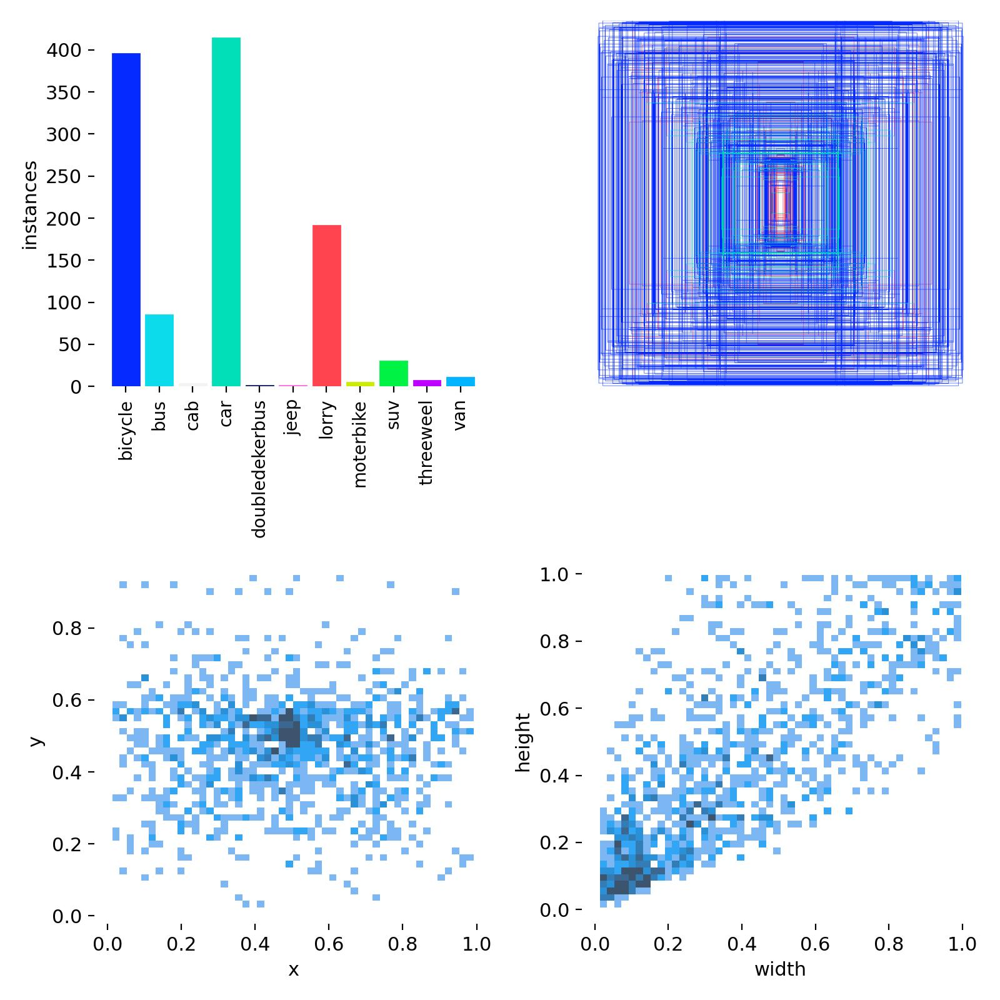

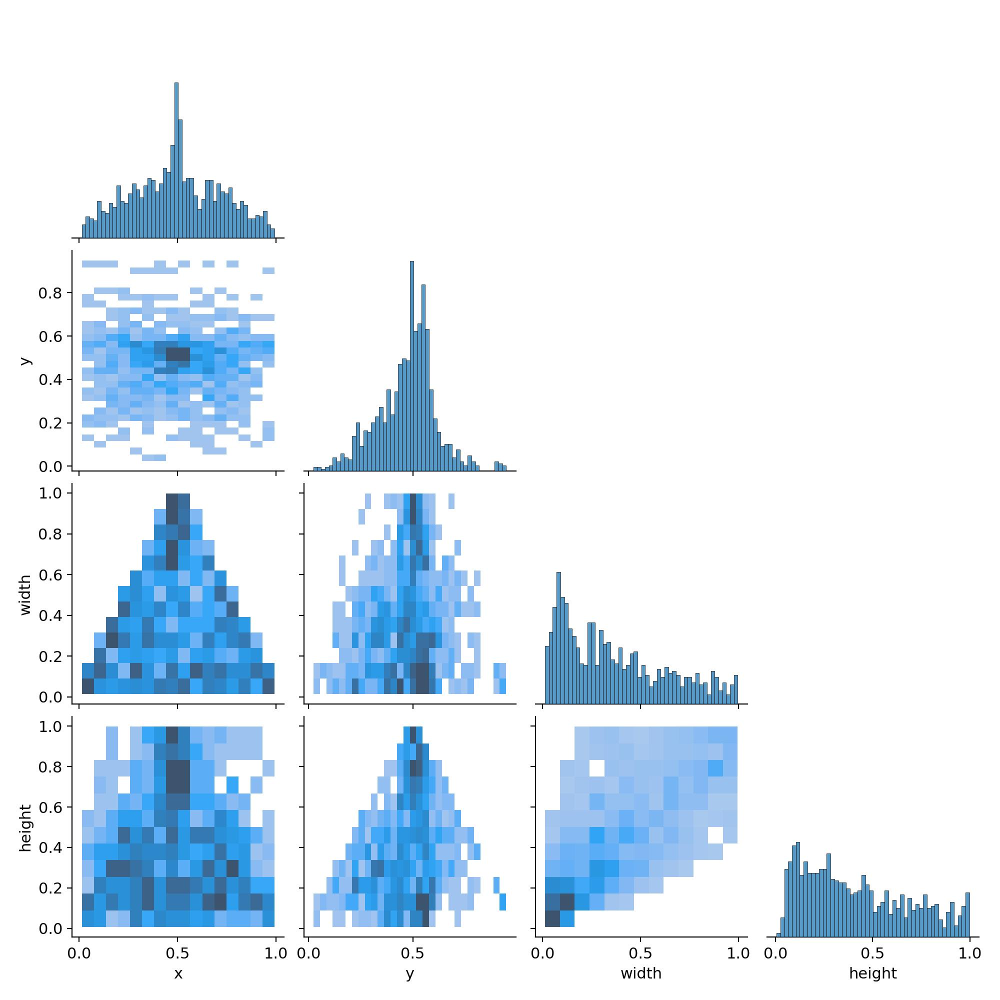

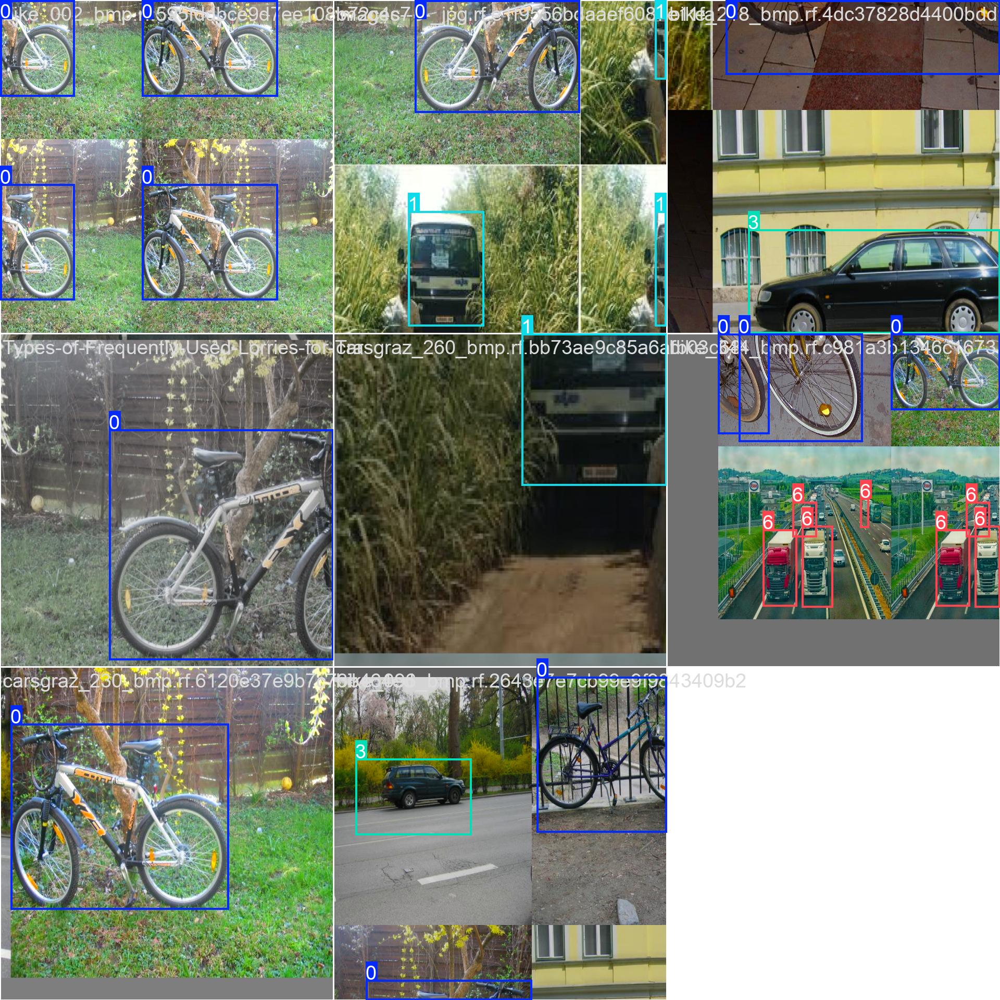

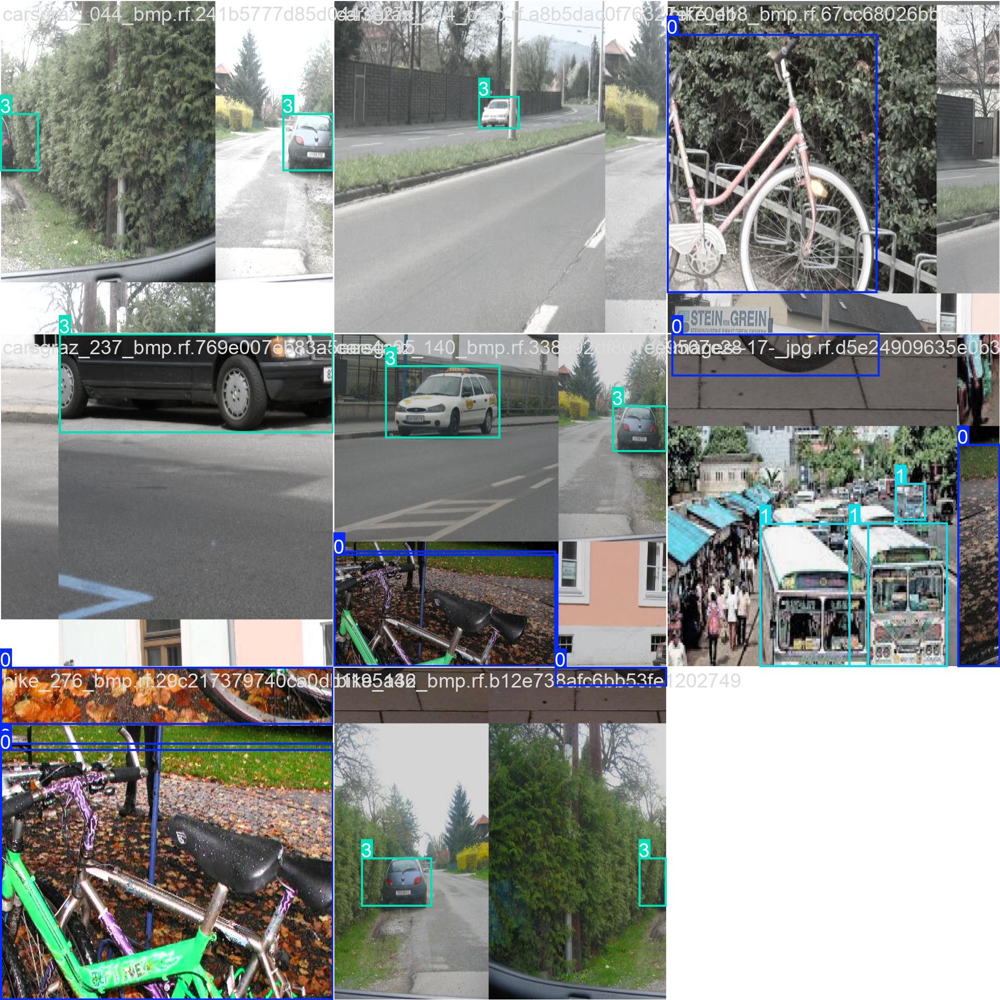

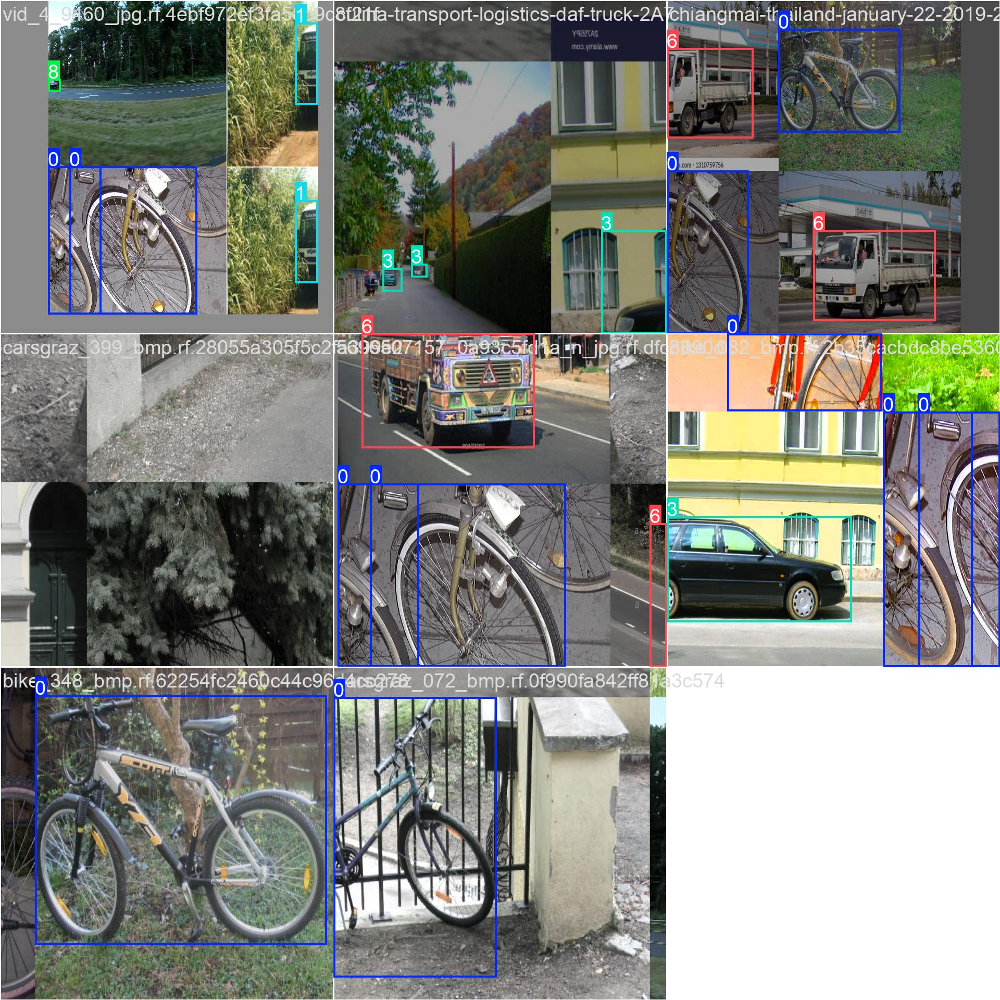

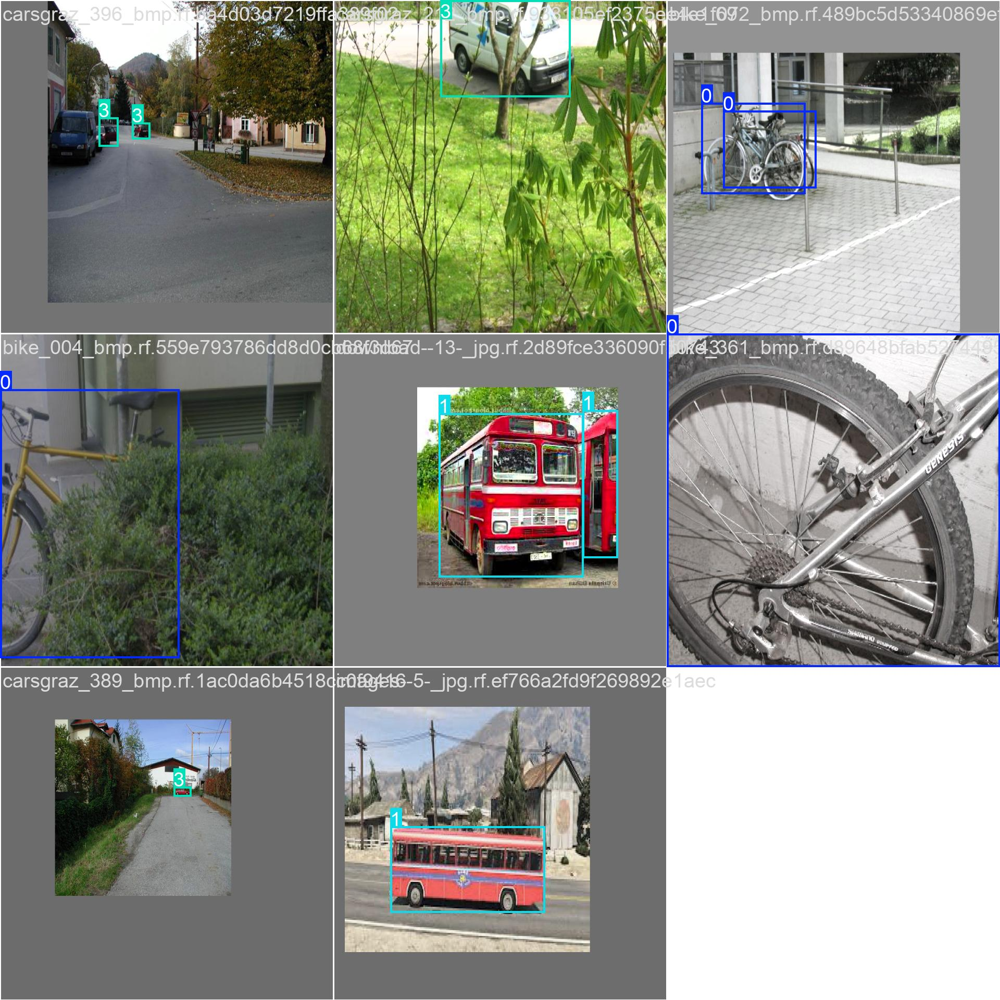

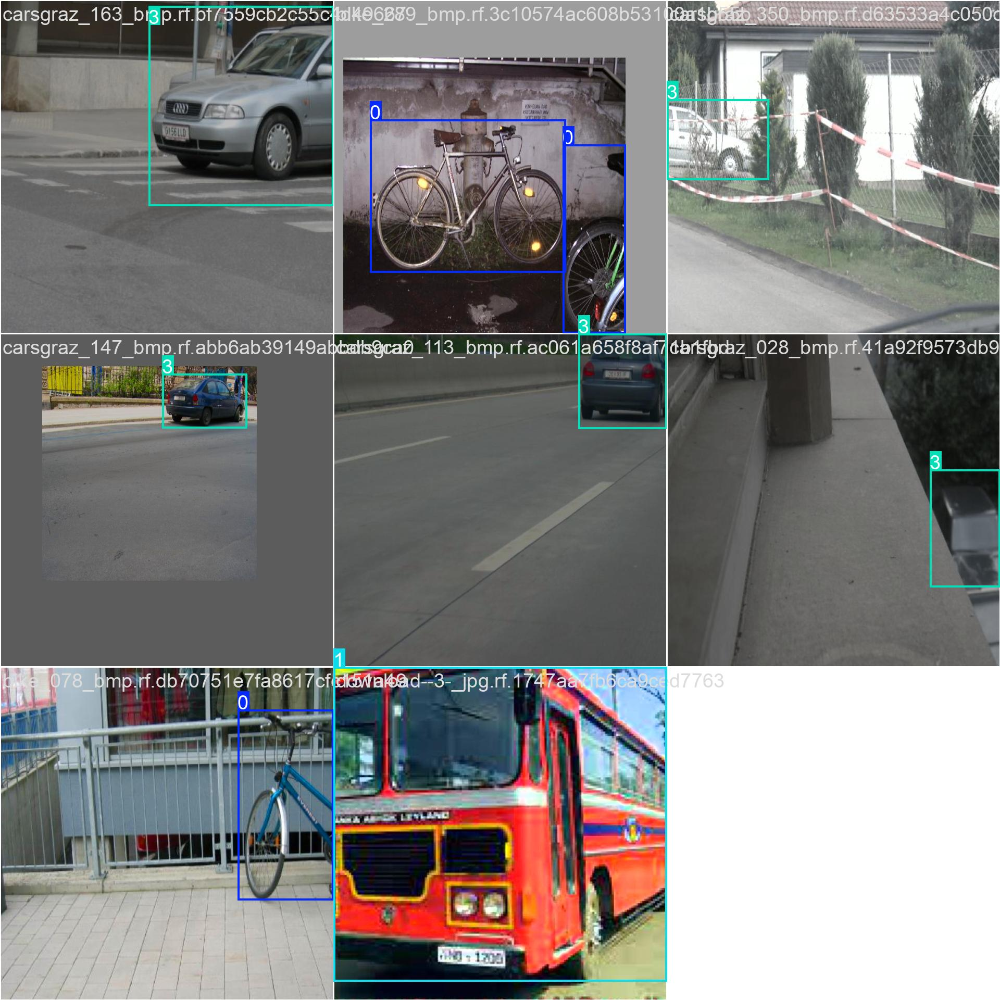

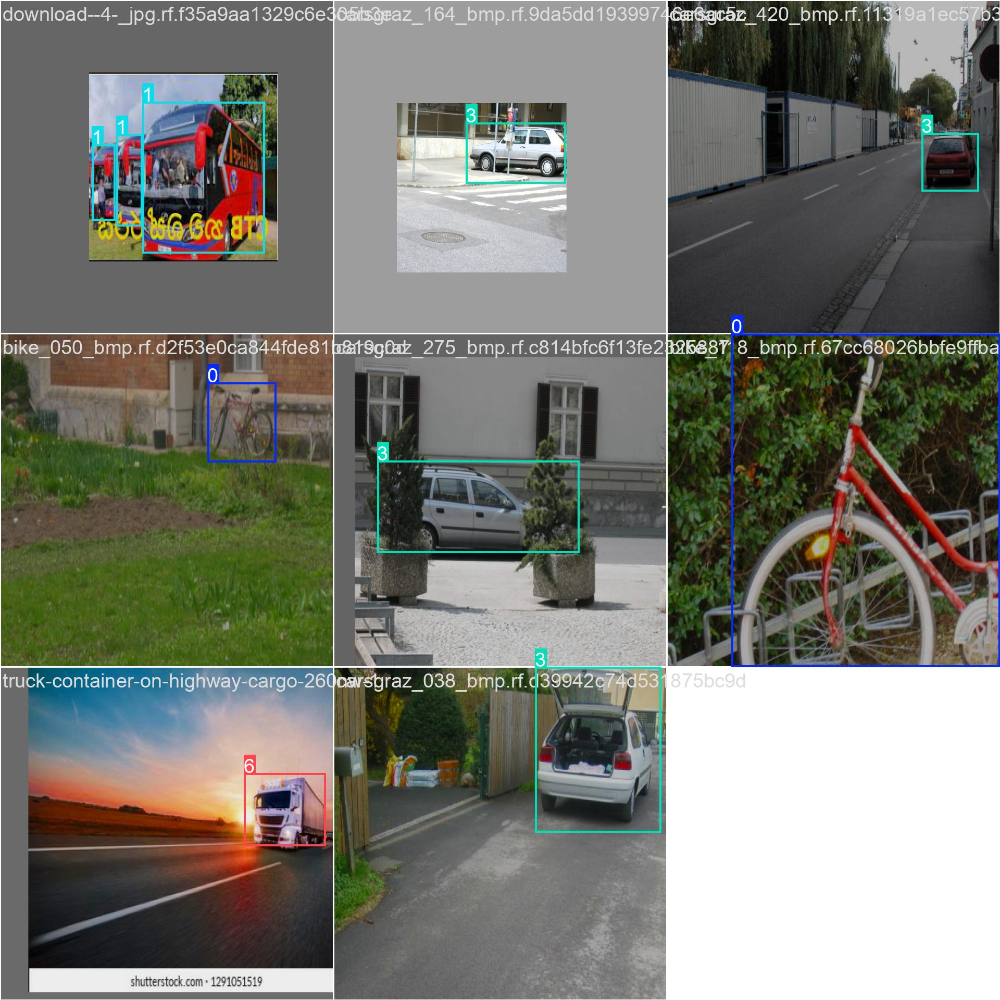

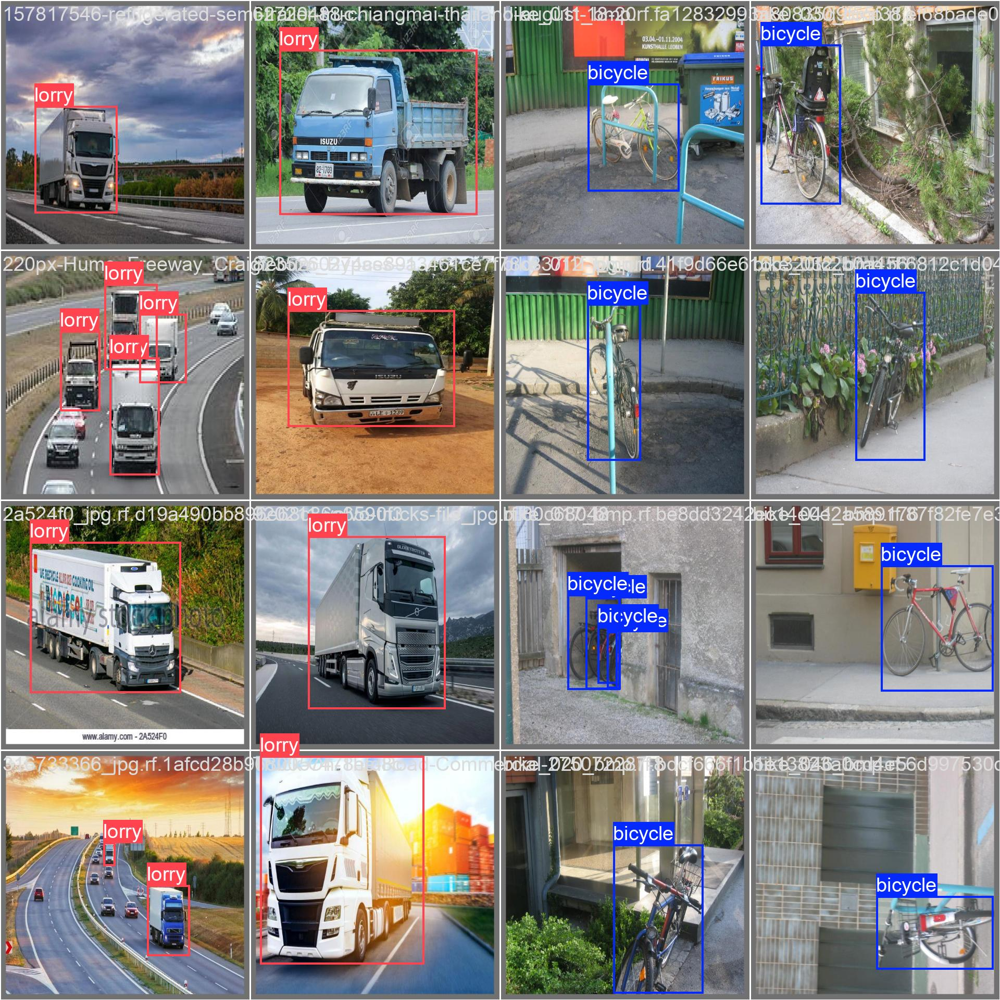

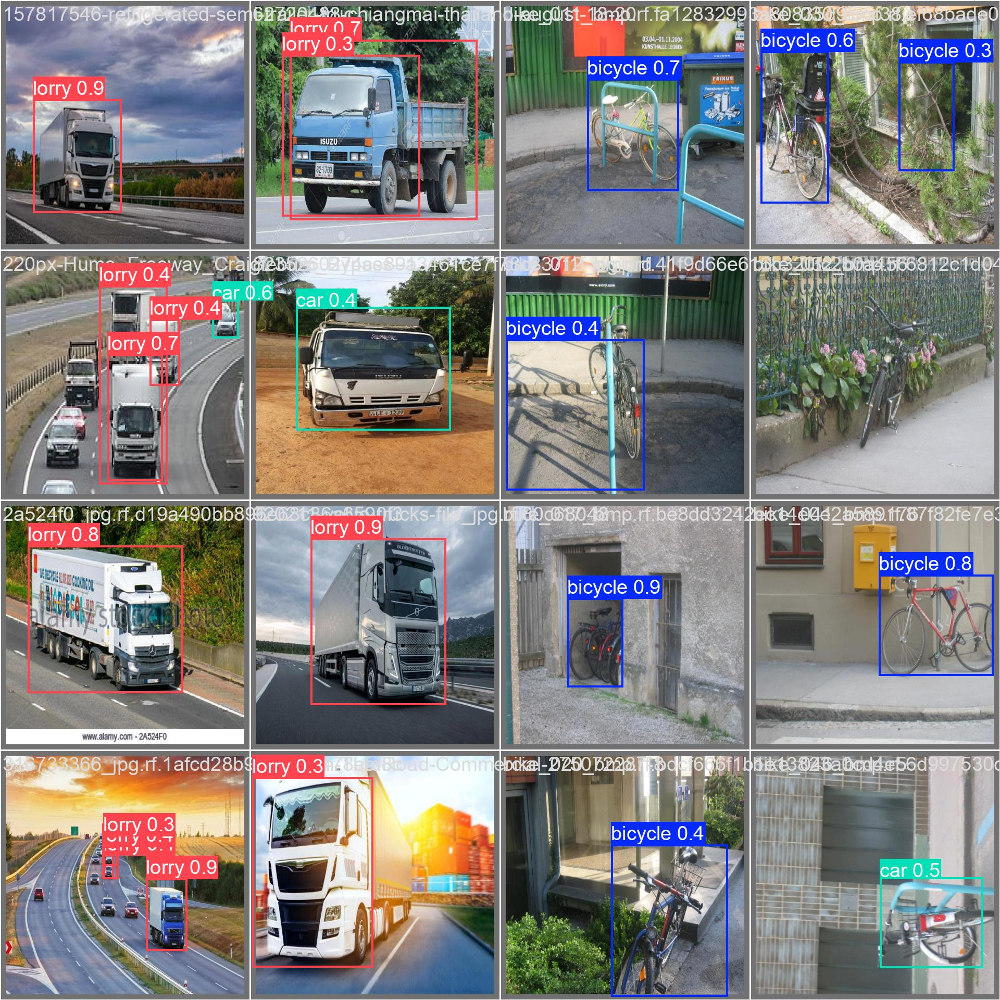

In [ ]:
from IPython.display import Image, display
import glob
for image_path in sorted(glob.glob('/content/runs/detect/vehicle-1/*.jpg'))[:10]:
  display(Image(filename=image_path))

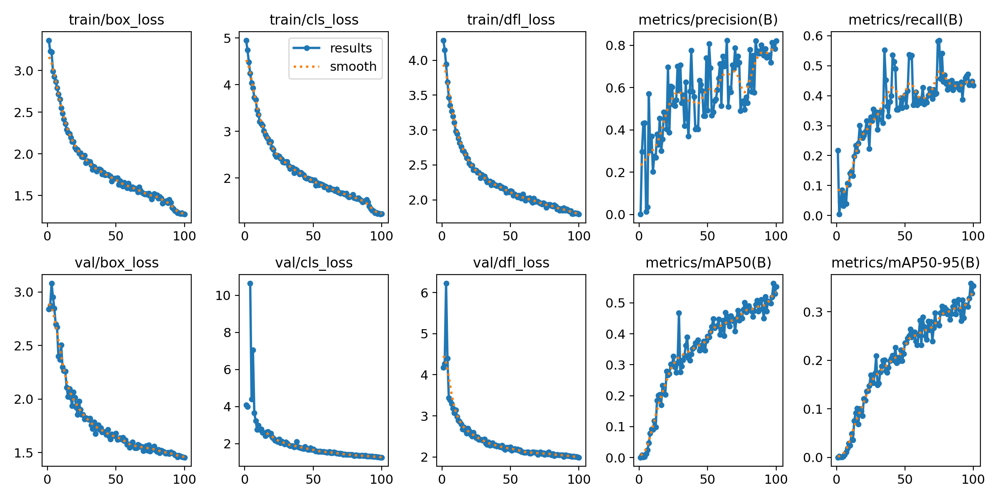

In [ ]:
from IPython.display import Image, display
display(Image(filename='/content/runs/detect/vehicle-1/results.png'))

In [ ]:
!ls /content/runs/detect


vehicle-1  vehicle-12  vehicle-13


In [ ]:
!pip install Ipython

In [ ]:
predict_folders = glob.glob('/content/runs/detect/predict*')


In [ ]:
output_folder = '/content/runs/detect/vehicle-13'  # or whichever folder has results


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import glob, os

output_folder = '/content/runs/detect/vehicle-13'

output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if not output_videos:
    print("⚠️ No output video found in", output_folder)
else:
    output_video = output_videos[0]
    print(f"🎥 Output video saved at: {output_video}")

    mp4_bytes = open(output_video, 'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    display(HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>'))


⚠️ No output video found in /content/runs/detect/vehicle-13


In [ ]:
!ls /content/runs/detect/vehicle-13


157817546-refrigerated-semi-trailer-truck-driving-on-a-highway-under-a-dramatic-sunset-sky-_jpg.rf.3ca0772d734f2cd86eade62bbad9cfb2.jpg
220px-Hume_Freeway_Craigieburn_Bypass--1-_jpg.rf.83a52bf1dd59c175475aaecd106f438d.jpg
2a524f0_jpg.rf.d19a490bb896e68c86a6590f3ce09458.jpg
316733366_jpg.rf.1afcd28b9680057478efd8ca62f04e43.jpg
62720488-chiangmai-thailand-august-18-2016-private-old-isuzu-dump-truck-on-road-no-1001-8-km-from-chiangmai-c_jpg.rf.bfa8e144004d0f8834f07fbce4517b3a.jpg
8235260274ce89a3461ce7f78c837f1f-jpg-crdownload_jpg.rf.ae288d31ea3d8fafa1485ac86b698d87.jpg
920211-volvo-trucks-file_jpg.rf.80c680487afc0a887dad7a92731239d9.jpg
bike_011_bmp.rf.fa12832993a80835d9f55f382d2b6dfa.jpg
bike_012_bmp.rf.41f9d66e616b320fc2b0a4560f9fb564.jpg
bike_017_bmp.rf.be8dd3242ec14e0e2a5891762b5865ca.jpg
bike_020_bmp.rf.bdcf666f1b1e13823a0cd4e5c5efe346.jpg
bike_030_bmp.rf.ef68bade0b8959d88a0ad00db73c5c67.jpg
bike_032_bmp.rf.6812c1d04a176af69e3f1d0f81ddd06b.jpg
bike_041_bmp.rf.87f82fe7e3ea3e5c66e135f

In [ ]:
!yolo task=detect mode=predict model=/content/runs/detect/vehicle-1/weights/best.pt source="/content/test_video.mp4" save=True


FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,078,465 parameters, 0 gradients, 19.3 GFLOPs

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 983, in entrypoint
    getattr(model, mode)(**overrides)  # default args from model
    ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 560, in predict
    return self.predictor.predict_cli(source=source) if is_cli else self.predictor(source=source, stream=stream)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/predictor.py", line 188, in predict_cli
    for _ in gen:  # sour

In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/vehicle-1/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

Saving 3.exe to 3 (4).exe
Uploaded video: 3 (4).exe
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,078,465 parameters, 0 gradients, 19.3 GFLOPs

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 983, in entrypoint
    getattr(model, mode)(**overrides)  # default args from model
    ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 560, in predict
    return self.predictor.predict_cli(source=source) if is_cli else self.predictor(source=source, stream=stream)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/predictor.py"

IndexError: list index out of range

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/vehicle12/weights/best.pt data=/content/vehicle-1/data.yaml

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 954, in entrypoint
    model = YOLO(model, task=task)
            ^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/models/yolo/model.py", line 23, in __init__
    super().__init__(model=model, task=task, verbose=verbose)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 148, in __init__
    self._load(model, task=task)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 291, in _load
    self.model, self.ckpt = attempt_load_one_weight(weights)
                            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/nn/tasks.py", line 9

In [ ]:
!ls /content/runs/detect/vehicle-13

157817546-refrigerated-semi-trailer-truck-driving-on-a-highway-under-a-dramatic-sunset-sky-_jpg.rf.3ca0772d734f2cd86eade62bbad9cfb2.jpg
220px-Hume_Freeway_Craigieburn_Bypass--1-_jpg.rf.83a52bf1dd59c175475aaecd106f438d.jpg
2a524f0_jpg.rf.d19a490bb896e68c86a6590f3ce09458.jpg
316733366_jpg.rf.1afcd28b9680057478efd8ca62f04e43.jpg
62720488-chiangmai-thailand-august-18-2016-private-old-isuzu-dump-truck-on-road-no-1001-8-km-from-chiangmai-c_jpg.rf.bfa8e144004d0f8834f07fbce4517b3a.jpg
8235260274ce89a3461ce7f78c837f1f-jpg-crdownload_jpg.rf.ae288d31ea3d8fafa1485ac86b698d87.jpg
920211-volvo-trucks-file_jpg.rf.80c680487afc0a887dad7a92731239d9.jpg
bike_011_bmp.rf.fa12832993a80835d9f55f382d2b6dfa.jpg
bike_012_bmp.rf.41f9d66e616b320fc2b0a4560f9fb564.jpg
bike_017_bmp.rf.be8dd3242ec14e0e2a5891762b5865ca.jpg
bike_020_bmp.rf.bdcf666f1b1e13823a0cd4e5c5efe346.jpg
bike_030_bmp.rf.ef68bade0b8959d88a0ad00db73c5c67.jpg
bike_032_bmp.rf.6812c1d04a176af69e3f1d0f81ddd06b.jpg
bike_041_bmp.rf.87f82fe7e3ea3e5c66e135f

In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/vehicle13/weights/best.pt data=/content/vehicle-1/data.yaml

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 954, in entrypoint
    model = YOLO(model, task=task)
            ^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/models/yolo/model.py", line 23, in __init__
    super().__init__(model=model, task=task, verbose=verbose)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 148, in __init__
    self._load(model, task=task)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/engine/model.py", line 291, in _load
    self.model, self.ckpt = attempt_load_one_weight(weights)
                            ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/nn/tasks.py", line 9

In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/people-12/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

KeyboardInterrupt: 

In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/vehicle-1/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

Saving 5.mp4 to 5 (1).mp4
Uploaded video: 5 (1).mp4
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,078,465 parameters, 0 gradients, 19.3 GFLOPs

video 1/1 (frame 1/272) /content/5 (1).mp4: 640x384 1 car, 54.7ms
video 1/1 (frame 2/272) /content/5 (1).mp4: 640x384 1 car, 14.1ms
video 1/1 (frame 3/272) /content/5 (1).mp4: 640x384 1 car, 14.0ms
video 1/1 (frame 4/272) /content/5 (1).mp4: 640x384 1 car, 13.9ms
video 1/1 (frame 5/272) /content/5 (1).mp4: 640x384 2 cars, 17.6ms
video 1/1 (frame 6/272) /content/5 (1).mp4: 640x384 2 cars, 13.9ms
video 1/1 (frame 7/272) /content/5 (1).mp4: 640x384 1 car, 24.9ms
video 1/1 (frame 8/272) /content/5 (1).mp4: 640x384 1 car, 17.4ms
video 1/1 (frame 9/272) /content/5 (1).mp4: 640x384 1 car, 15.4ms
video 1/1 (frame 10/272) /content/5 (1).mp4: 640x384 1 car, 13.9ms
video 1/1 (frame 11/272) 

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

# Step 2: Get the output video file
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 3: Display the video in Colab
    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

No output video found.


In [ ]:
!yolo task=detect mode=predict \
     model=/content/runs/detect/vehicle-1/weights/best.pt \
     source="/content/5.mp4" \
     save=True \
     save_video=True

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 903, in entrypoint
    check_dict_alignment(full_args_dict, overrides)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 485, in check_dict_alignment
    raise SyntaxError(string + CLI_HELP_MSG) from e
SyntaxError: 'save_video' is not a valid YOLO argument. Similar arguments are i.e. ['save_period=-1', 'save_hybrid=False', 'save_json=False'].

    Arguments received: ['yolo', 'task=detect', 'mode=predict', 'model=/content/runs/detect/vehicle-1/weights/best.pt', 'source=/content/5.mp4', 'save=True', 'save_video=True']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of {'se

In [ ]:
!yolo task=detect mode=predict \
     model=/content/runs/detect/vehicle-13/weights/best.pt \
     source="/content/5.mp4" \
     save=True \
     save_video=True

FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
             ^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 903, in entrypoint
    check_dict_alignment(full_args_dict, overrides)
  File "/usr/local/lib/python3.12/dist-packages/ultralytics/cfg/__init__.py", line 485, in check_dict_alignment
    raise SyntaxError(string + CLI_HELP_MSG) from e
SyntaxError: 'save_video' is not a valid YOLO argument. Similar arguments are i.e. ['save_period=-1', 'save_hybrid=False', 'save_json=False'].

    Arguments received: ['yolo', 'task=detect', 'mode=predict', 'model=/content/runs/detect/vehicle-13/weights/best.pt', 'source=/content/5.mp4', 'save=True', 'save_video=True']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of {'o

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)

if not predict_folders:
    print("No prediction folders found.")
else:
    output_folder = predict_folders[-1]  # latest prediction folder

    # Step 2: Get the output video file (assuming it's the first mp4 found)
    output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

    if len(output_videos) == 0:
        print(f"No output video found in {output_folder}")
    else:
        output_video = output_videos[0]
        print(f"Output video saved at: {output_video}")

        # Step 3: Display the video in Colab
        mp4_bytes = open(output_video,'rb').read()
        data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
        display(HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>'))

No output video found in /content/runs/detect/predict


In [ ]:
# ✅ Convert AVI to MP4 and Display Inline

import glob
import os
from IPython.display import HTML
from base64 import b64encode

# Step 1: Find the latest predict folder safely
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)

if not predict_folders:
    print("⚠️ No predict folders found. Please run YOLO detection first.")
else:
    output_folder = predict_folders[-1]  # latest prediction folder
    print(f"✅ Latest prediction folder: {output_folder}")

    # Step 2: Find an AVI file inside that folder
    avi_files = glob.glob(os.path.join(output_folder, '*.avi'))
    if not avi_files:
        print("⚠️ No .avi video file found inside:", output_folder)
    else:
        avi_file = avi_files[0]
        mp4_output = os.path.join(output_folder, "annotated_video.mp4")

        # Step 3: Convert AVI to MP4
        !ffmpeg -y -i "{avi_file}" -c:v libx264 -pix_fmt yuv420p "{mp4_output}"

        # Step 4: Play the converted MP4 inline
        mp4_bytes = open(mp4_output, 'rb').read()
        data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()

        display(HTML(f'''
        <video width="640" controls>
            <source src="{data_url}" type="video/mp4">
        </video>
        '''))


✅ Latest prediction folder: /content/runs/detect/predict
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --en

In [ ]:
import os, shutil, glob

# === 1️⃣ Set Google Drive destination folder ===
dest_drive_folder = "/content/drive/MyDrive/YOLO_Backup"
os.makedirs(dest_drive_folder, exist_ok=True)

# === 2️⃣ Find the latest training folder (contains weights/best.pt) ===
train_folders = sorted(glob.glob('/content/runs/detect/*'), key=os.path.getmtime)
latest_train_folder = None

for folder in reversed(train_folders):
    if os.path.exists(os.path.join(folder, 'weights', 'best.pt')):
        latest_train_folder = folder
        break

if latest_train_folder:
    weights_src = os.path.join(latest_train_folder, 'weights', 'best.pt')
    weights_dest = os.path.join(dest_drive_folder, 'best.pt')
    shutil.copy2(weights_src, weights_dest)
    print(f"✅ Found model in: {latest_train_folder}")
    print(f"✅ Trained weights backed up to: {weights_dest}")
else:
    print("❌ No trained model with best.pt found in /runs/detect/")

# === 3️⃣ Find latest prediction folder ===
predict_folders = [f for f in train_folders if 'predict' in f]
if predict_folders:
    latest_predict_folder = max(predict_folders, key=os.path.getmtime)
    predict_dest = os.path.join(dest_drive_folder, 'predict_results')
    shutil.copytree(latest_predict_folder, predict_dest, dirs_exist_ok=True)
    print(f"✅ Prediction results backed up from: {latest_predict_folder}")
    print(f"✅ Saved to: {predict_dest}")
else:
    print("❌ No prediction folder found.")

# === 4️⃣ Backup the current notebook (if any) ===
notebooks = glob.glob('/content/*.ipynb')
if notebooks:
    latest_notebook = max(notebooks, key=os.path.getmtime)
    shutil.copy2(latest_notebook, dest_drive_folder)
    print(f"✅ Notebook backed up: {os.path.basename(latest_notebook)}")
else:
    print("❌ No notebook found in /content/")



In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/vehicle-1/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

Saving A.mp4 to A.mp4
Uploaded video: A.mp4
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,078,465 parameters, 0 gradients, 19.3 GFLOPs

video 1/1 (frame 1/202) /content/A.mp4: 640x384 1 car, 55.9ms
video 1/1 (frame 2/202) /content/A.mp4: 640x384 1 car, 14.0ms
video 1/1 (frame 3/202) /content/A.mp4: 640x384 1 car, 15.3ms
video 1/1 (frame 4/202) /content/A.mp4: 640x384 (no detections), 14.1ms
video 1/1 (frame 5/202) /content/A.mp4: 640x384 (no detections), 14.4ms
video 1/1 (frame 6/202) /content/A.mp4: 640x384 (no detections), 16.0ms
video 1/1 (frame 7/202) /content/A.mp4: 640x384 (no detections), 27.0ms
video 1/1 (frame 8/202) /content/A.mp4: 640x384 (no detections), 16.6ms
video 1/1 (frame 9/202) /content/A.mp4: 640x384 (no detections), 15.4ms
video 1/1 (frame 10/202) /content/A.mp4: 640x384 (no detections), 14.3ms
video

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import glob
import os

# Step 1: Find the latest predict folder
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder

# Step 2: Get the output video file
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))
if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 3: Display the video in Colab
    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

No output video found.


In [ ]:
# ✅ Convert AVI to MP4 and Display Inline

import glob
import os
from IPython.display import HTML
from base64 import b64encode

# Step 1: Find the latest predict folder safely
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)

if not predict_folders:
    print("⚠️ No predict folders found. Please run YOLO detection first.")
else:
    output_folder = predict_folders[-1]  # latest prediction folder
    print(f"✅ Latest prediction folder: {output_folder}")

    # Step 2: Find an AVI file inside that folder
    avi_files = glob.glob(os.path.join(output_folder, '*.avi'))
    if not avi_files:
        print("⚠️ No .avi video file found inside:", output_folder)
    else:
        avi_file = avi_files[0]
        mp4_output = os.path.join(output_folder, "annotated_video.mp4")

        # Step 3: Convert AVI to MP4
        !ffmpeg -y -i "{avi_file}" -c:v libx264 -pix_fmt yuv420p "{mp4_output}"

        # Step 4: Play the converted MP4 inline
        mp4_bytes = open(mp4_output, 'rb').read()
        data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()

        display(HTML(f'''
        <video width="640" controls>
            <source src="{data_url}" type="video/mp4">
        </video>
        '''))


✅ Latest prediction folder: /content/runs/detect/predict2
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --e

In [ ]:
from google.colab import drive
import shutil
import os
import datetime

# 1️⃣ Mount Google Drive
drive.mount('/content/drive')

# 2️⃣ Set backup folder in Drive
backup_root = '/content/drive/MyDrive/YOLO_Backups'
os.makedirs(backup_root, exist_ok=True)

# 3️⃣ Timestamp for unique backup
timestamp = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')

# 4️⃣ Paths to backup
folders_to_backup = [
    '/content/runs/detect',   # YOLO outputs
    '/content/vehicle-1',     # your dataset folder (if needed)
]
notebook_file = '/content/your_notebook.ipynb'  # change this to your current notebook name

# 5️⃣ Copy folders
for folder in folders_to_backup:
    if os.path.exists(folder):
        dest = os.path.join(backup_root, f"{os.path.basename(folder)}_{timestamp}")
        shutil.copytree(folder, dest)
        print(f"Backed up folder {folder} → {dest}")

# 6️⃣ Copy notebook
if os.path.exists(notebook_file):
    notebook_dest = os.path.join(backup_root, f"{os.path.basename(notebook_file).replace('.ipynb','')}_{timestamp}.ipynb")
    shutil.copy(notebook_file, notebook_dest)
    print(f"Backed up notebook → {notebook_dest}")

print("✅ Backup completed!")


Mounted at /content/drive
Backed up folder /content/runs/detect → /content/drive/MyDrive/YOLO_Backups/detect_2025-10-12_11-16-13
Backed up folder /content/vehicle-1 → /content/drive/MyDrive/YOLO_Backups/vehicle-1_2025-10-12_11-16-13
✅ Backup completed!


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="5LHxU2EzBUuKnJjsORdB")
project = rf.workspace("kanok-54pgt").project("zebra-crossing-detector-yrk1e")
version = project.version(1)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to zebra-crossing-detector-1 in yolov8:: 100%|██████████| 1410/1410 [00:00<00:00, 6160.94it/s]


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/yolov12/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.


In [ ]:
!ls /content

sample_data  zebra-crossing-detector-1


In [ ]:
from ultralytics import YOLO

model = YOLO('yolov12s.yaml')

results = model.train(data=f'/content/zebra-crossing-detector-1/data.yaml', epochs=100,imgsz=640,batch=8,name="zebra-crossing-detector-1")

New https://pypi.org/project/ultralytics/8.3.241 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.63 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov12s.yaml, data=/content/zebra-crossing-detector-1/data.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=zebra-crossing-detector-1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=F

100%|██████████| 755k/755k [00:00<00:00, 107MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1      9344  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2, 1, 2]          
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1     37120  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2, 1, 4]        
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  2    677120  ultralytics.nn.modules.block.A2C2f           [256, 256, 2, True, 4]        
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.26M/5.26M [00:00<00:00, 109MB/s]


AMP: checks passed ✅


train: Scanning /content/zebra-crossing-detector-1/train/labels... 576 images, 0 backgrounds, 0 corrupt: 100%|██████████| 576/576 [00:00<00:00, 2204.08it/s]

train: New cache created: /content/zebra-crossing-detector-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression
val: Scanning /content/zebra-crossing-detector-1/valid/labels... 82 images, 0 backgrounds, 0 corrupt: 100%|██████████| 82/82 [00:00<00:00, 1652.40it/s]

val: New cache created: /content/zebra-crossing-detector-1/valid/labels.cache


Plotting labels to runs/detect/zebra-crossing-detector-1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 121 weight(decay=0.0), 128 weight(decay=0.0005), 127 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/zebra-crossing-detector-1
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.59G      3.808      4.239      4.133         19        640: 100%|██████████| 72/72 [00:35<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:10<00:00,  1.79s/it]

                   all         82         92   0.000854      0.228    0.00103   0.000296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      3.62G      3.437      3.855      3.797         11        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.01it/s]

                   all         82         92   0.000622      0.163   0.000715   0.000194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      3.69G      3.123      3.598      3.461         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.23it/s]

                   all         82         92    0.00712      0.087      0.004    0.00112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      3.62G      2.966      3.427      3.285         13        640: 100%|██████████| 72/72 [00:21<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.30it/s]

                   all         82         92     0.0155     0.0435    0.00333   0.000909



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.62G      2.895      3.327      3.201         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.42it/s]

                   all         82         92     0.0223      0.087     0.0072    0.00165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      3.62G      2.809      3.175      3.119         12        640: 100%|██████████| 72/72 [00:21<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         82         92     0.0837      0.163     0.0666     0.0146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.62G      2.754      3.077      3.054         11        640: 100%|██████████| 72/72 [00:21<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.36it/s]

                   all         82         92      0.118       0.37      0.124     0.0371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      3.62G      2.706      2.984      2.996         21        640: 100%|██████████| 72/72 [00:21<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.45it/s]

                   all         82         92      0.204      0.196     0.0789     0.0209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      3.62G      2.661      2.962      2.947         11        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.40it/s]

                   all         82         92     0.0893      0.152     0.0833     0.0203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      3.61G      2.595      2.947      2.917         19        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.25it/s]

                   all         82         92       0.23      0.261      0.153     0.0442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      3.61G      2.639      2.855      2.898         19        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.29it/s]

                   all         82         92      0.204      0.287      0.175     0.0516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      3.62G      2.557      2.824      2.871         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.35it/s]

                   all         82         92       0.24      0.193      0.182      0.047



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      3.61G      2.599      2.738      2.847         14        640: 100%|██████████| 72/72 [00:21<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.39it/s]

                   all         82         92      0.179      0.424      0.211     0.0515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      3.62G      2.555      2.655      2.825         11        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.34it/s]

                   all         82         92      0.227      0.274      0.209     0.0563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      3.61G      2.496      2.602      2.778         19        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.33it/s]

                   all         82         92      0.239      0.386      0.229     0.0641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      3.62G      2.469      2.568      2.781         12        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         82         92      0.321      0.402      0.235     0.0777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      3.61G       2.42      2.544      2.762         23        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.40it/s]

                   all         82         92      0.271      0.242      0.221     0.0594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      3.62G       2.46       2.53      2.718         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         82         92      0.227       0.38      0.221     0.0589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      3.61G      2.443      2.497       2.71         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.99it/s]

                   all         82         92      0.249       0.37      0.257     0.0802



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      3.62G      2.399      2.408      2.722         14        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.57it/s]

                   all         82         92      0.416      0.348      0.348      0.111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      3.61G        2.4      2.395      2.691         16        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.54it/s]

                   all         82         92      0.357      0.402      0.326     0.0794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      3.62G      2.386      2.385      2.685         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         82         92      0.324      0.348      0.249     0.0734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      3.62G      2.369      2.372      2.664         14        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.46it/s]

                   all         82         92      0.335      0.467      0.337      0.108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      3.61G      2.324      2.259      2.652         18        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.42it/s]

                   all         82         92      0.425      0.543      0.432      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      3.62G      2.325      2.275      2.646         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.15it/s]

                   all         82         92      0.392      0.489      0.408      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      3.61G      2.273      2.287      2.608         17        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.44it/s]

                   all         82         92      0.376      0.446      0.377      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      3.62G      2.266      2.201      2.586         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.356      0.652      0.411      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      3.62G      2.269      2.214      2.597         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         82         92      0.399      0.457      0.414      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      3.62G      2.212      2.163      2.539         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92       0.38       0.44      0.382      0.125



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      3.62G      2.231       2.14      2.536         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.46it/s]

                   all         82         92      0.543      0.522      0.514      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      3.62G      2.195      2.138      2.529         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         82         92      0.429      0.636      0.475      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      3.61G      2.184      2.115      2.533         18        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.17it/s]

                   all         82         92       0.57      0.543      0.565      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      3.61G      2.172      2.091      2.514         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.41it/s]

                   all         82         92      0.389      0.553      0.441      0.146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      3.61G      2.151      2.129      2.512         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.35it/s]

                   all         82         92      0.441       0.54      0.486      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      3.61G      2.193      2.075      2.526         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         82         92      0.456      0.543      0.479      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      3.62G      2.171      2.062      2.538         21        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         82         92      0.401      0.489      0.452      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.61G      2.189      2.081      2.507         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.85it/s]

                   all         82         92      0.444      0.717      0.612      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      3.62G      2.108      1.978      2.431         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.96it/s]

                   all         82         92      0.552      0.615      0.584      0.188



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.62G      2.083      1.948      2.441         16        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.39it/s]

                   all         82         92      0.531      0.591      0.588      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.61G      2.147      2.012      2.479         11        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         82         92      0.528      0.587      0.624      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      3.62G      2.068       1.94      2.411         21        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.49it/s]

                   all         82         92      0.612      0.617      0.622      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      3.61G      2.055      1.894      2.387         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.35it/s]

                   all         82         92      0.477      0.685      0.568      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      3.62G      2.039      1.889      2.363         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.87it/s]

                   all         82         92      0.584      0.609      0.594      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      3.62G      2.059      1.907      2.407         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.69it/s]

                   all         82         92      0.433      0.674        0.5      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.61G      2.062      1.894      2.429         15        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.44it/s]

                   all         82         92      0.612      0.717      0.655      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      3.62G      2.033      1.862      2.396         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         82         92      0.526      0.609      0.546        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      3.62G      2.017      1.856      2.392         14        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.40it/s]

                   all         82         92      0.626      0.717      0.688       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      3.62G      2.085       1.86      2.427         19        640: 100%|██████████| 72/72 [00:21<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.646      0.609       0.69      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.61G      2.047      1.822      2.395         19        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.48it/s]

                   all         82         92      0.658      0.523      0.611      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      3.62G      2.001      1.803      2.337         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.99it/s]

                   all         82         92      0.529       0.63      0.639      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.62G       2.02      1.789      2.352         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.574      0.663      0.634      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      3.62G       2.08      1.785      2.389         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         82         92       0.61      0.685      0.627      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      3.62G      2.005      1.781      2.342         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.40it/s]

                   all         82         92      0.624      0.685       0.68      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      3.61G      1.987      1.774      2.316         21        640: 100%|██████████| 72/72 [00:21<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.44it/s]

                   all         82         92      0.675      0.728      0.746       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.62G      2.023      1.806      2.358         17        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.48it/s]

                   all         82         92      0.663      0.662      0.684      0.239



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      3.61G      1.942      1.743      2.301         16        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.42it/s]

                   all         82         92      0.621      0.761      0.731      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      3.62G      2.011       1.77      2.351         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         82         92      0.613      0.696      0.666      0.278



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      3.62G       1.98      1.719      2.291         18        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.576      0.685      0.598      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.61G      1.937      1.744      2.282         15        640: 100%|██████████| 72/72 [00:22<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         82         92      0.689      0.602      0.703      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      3.62G      1.929       1.73      2.286         12        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.46it/s]

                   all         82         92      0.707      0.717      0.723      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.61G      1.972      1.704      2.298         14        640: 100%|██████████| 72/72 [00:20<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.58it/s]

                   all         82         92      0.634      0.761      0.726      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      3.62G      1.939      1.682      2.311         17        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         82         92      0.703      0.771      0.746      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      3.62G      1.898      1.655      2.258         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         82         92      0.762      0.761       0.78      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.61G      1.916      1.678      2.256         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.38it/s]

                   all         82         92      0.685      0.674      0.759      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.62G      1.889       1.65      2.233         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.44it/s]

                   all         82         92      0.747      0.717       0.77      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.61G       1.89      1.636      2.245         10        640: 100%|██████████| 72/72 [00:23<00:00,  3.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         82         92       0.58      0.739      0.645      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      3.62G      1.882      1.635      2.248         11        640: 100%|██████████| 72/72 [00:21<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.35it/s]

                   all         82         92      0.783      0.739      0.758      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      3.62G      1.916      1.664      2.254         16        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.63it/s]

                   all         82         92      0.777      0.772      0.777      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.61G      1.837      1.573      2.204         12        640: 100%|██████████| 72/72 [00:20<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.50it/s]

                   all         82         92      0.766      0.749      0.782      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      3.62G      1.911      1.584      2.251         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         82         92      0.776      0.753      0.771      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      3.62G      1.939      1.595      2.236         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.51it/s]

                   all         82         92      0.741      0.746      0.768      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.61G      1.877      1.587      2.228         12        640: 100%|██████████| 72/72 [00:21<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         82         92      0.724      0.793      0.799      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.62G      1.879      1.589        2.2         19        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.09it/s]

                   all         82         92      0.733      0.685      0.743       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      3.62G       1.87      1.545      2.193         21        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.61it/s]

                   all         82         92      0.735      0.761      0.742      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.62G      1.837      1.572        2.2         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.44it/s]

                   all         82         92      0.723      0.783      0.775      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      3.61G      1.819      1.555      2.167         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.53it/s]

                   all         82         92      0.778      0.783      0.776      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      3.62G      1.874      1.588      2.214         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.57it/s]

                   all         82         92      0.814       0.75      0.833      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      3.61G      1.846      1.556       2.16         20        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.44it/s]

                   all         82         92      0.751      0.756      0.778      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.61G      1.816      1.529      2.144         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.87it/s]

                   all         82         92      0.805      0.793      0.829      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.62G      1.814      1.581      2.149         20        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.01it/s]

                   all         82         92      0.694      0.685      0.722      0.298



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.61G      1.793      1.553      2.166         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.48it/s]

                   all         82         92      0.785      0.739      0.802       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      3.62G      1.826      1.557      2.169         12        640: 100%|██████████| 72/72 [00:21<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.46it/s]

                   all         82         92      0.749      0.804      0.811      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      3.61G      1.816      1.504      2.112         13        640: 100%|██████████| 72/72 [00:21<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.42it/s]

                   all         82         92       0.76      0.793      0.821      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      3.62G      1.799        1.5      2.119         22        640: 100%|██████████| 72/72 [00:21<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]

                   all         82         92      0.816      0.837      0.887      0.312



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      3.62G      1.798      1.493      2.119         17        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.43it/s]

                   all         82         92      0.777      0.772      0.806      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      3.61G       1.76      1.517      2.096         13        640: 100%|██████████| 72/72 [00:20<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.832      0.826      0.838      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      3.62G      1.784      1.511      2.153         15        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.49it/s]

                   all         82         92      0.751      0.772      0.763      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      3.61G      1.771      1.482       2.12         18        640: 100%|██████████| 72/72 [00:21<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.48it/s]

                   all         82         92      0.792      0.772      0.801      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.62G       1.76       1.47      2.086         16        640: 100%|██████████| 72/72 [00:21<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.55it/s]

                   all         82         92      0.791      0.804       0.82      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      3.61G      1.735       1.46       2.08         15        640: 100%|██████████| 72/72 [00:22<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.45it/s]

                   all         82         92       0.77      0.815      0.801      0.329


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


Argument(s) 'quality_lower' are not valid for transform ImageCompression



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      3.62G      1.729      1.364      2.095          9        640: 100%|██████████| 72/72 [00:22<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.31it/s]

                   all         82         92      0.783      0.804      0.839      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      3.62G        1.7      1.239      2.111          8        640: 100%|██████████| 72/72 [00:22<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  3.37it/s]

                   all         82         92      0.811      0.791       0.83      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      3.61G      1.687      1.206      2.081          8        640: 100%|██████████| 72/72 [00:20<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.46it/s]

                   all         82         92      0.822      0.804      0.839      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      3.62G      1.702      1.179      2.082          8        640: 100%|██████████| 72/72 [00:20<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.47it/s]

                   all         82         92      0.842      0.814      0.835       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      3.61G      1.706      1.169      2.085          8        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.46it/s]

                   all         82         92      0.854      0.825      0.844      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      3.62G       1.69      1.153      2.072         10        640: 100%|██████████| 72/72 [00:21<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.869      0.795      0.856      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      3.62G      1.644      1.159      2.063          8        640: 100%|██████████| 72/72 [00:21<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.43it/s]

                   all         82         92      0.873      0.783      0.862      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      3.61G      1.674      1.167      2.054          9        640: 100%|██████████| 72/72 [00:20<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.77it/s]

                   all         82         92      0.863      0.772      0.847      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      3.62G      1.656      1.123      2.032          9        640: 100%|██████████| 72/72 [00:20<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  4.73it/s]

                   all         82         92      0.874      0.793       0.87      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      3.62G      1.656      1.142      2.055          8        640: 100%|██████████| 72/72 [00:21<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:01<00:00,  5.54it/s]

                   all         82         92      0.882      0.793      0.874      0.362



100 epochs completed in 0.662 hours.
Optimizer stripped from runs/detect/zebra-crossing-detector-1/weights/last.pt, 18.6MB
Optimizer stripped from runs/detect/zebra-crossing-detector-1/weights/best.pt, 18.6MB

Validating runs/detect/zebra-crossing-detector-1/weights/best.pt...
Ultralytics 8.3.63 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,074,595 parameters, 0 gradients, 19.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.66it/s]


                   all         82         92      0.883      0.793      0.874      0.362
Speed: 0.5ms preprocess, 13.4ms inference, 0.0ms loss, 4.8ms postprocess per image
Results saved to runs/detect/zebra-crossing-detector-1


In [ ]:
# Step 1: Upload your video
from google.colab import files
uploaded = files.upload()  # Upload your video file (e.g., road_test.mp4)

# Get the uploaded file name
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

# Step 2: Run YOLO detection on the video
!yolo task=detect mode=predict model=/content/runs/detect/zebra-crossing-detector-1/weights/best.pt source="/content/{video_path}" save=True

# Step 3: Find the output video (YOLO saves it in runs/detect/predict*/ folder)
import glob
import os

predict_folders = sorted(glob.glob('/content/runs/detect/zebra-crossing-detector-1*'), key=os.path.getmtime)
output_folder = predict_folders[-1]  # latest prediction folder
output_videos = glob.glob(os.path.join(output_folder, '*.mp4'))

if len(output_videos) == 0:
    print("No output video found.")
else:
    output_video = output_videos[0]
    print(f"Output video saved at: {output_video}")

    # Step 4: Display the video in Colab
    from IPython.display import HTML
    from base64 import b64encode

    mp4_bytes = open(output_video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()
    HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4"></video>')

Saving 4.mp4 to 4 (1).mp4
Uploaded video: 4 (1).mp4
FlashAttention is not available on this device. Using scaled_dot_product_attention instead.
Ultralytics 8.3.63 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12s summary (fused): 376 layers, 9,074,595 parameters, 0 gradients, 19.3 GFLOPs

video 1/1 (frame 1/230) /content/4 (1).mp4: 640x384 (no detections), 58.4ms
video 1/1 (frame 2/230) /content/4 (1).mp4: 640x384 (no detections), 15.8ms
video 1/1 (frame 3/230) /content/4 (1).mp4: 640x384 (no detections), 15.1ms
video 1/1 (frame 4/230) /content/4 (1).mp4: 640x384 (no detections), 16.7ms
video 1/1 (frame 5/230) /content/4 (1).mp4: 640x384 (no detections), 16.2ms
video 1/1 (frame 6/230) /content/4 (1).mp4: 640x384 (no detections), 21.0ms
video 1/1 (frame 7/230) /content/4 (1).mp4: 640x384 (no detections), 15.9ms
video 1/1 (frame 8/230) /content/4 (1).mp4: 640x384 (no detections), 15.1ms
video 1/1 (frame 9/230) /content/4 (1).mp4: 640x384 1 zebra crossing, 14.0ms
vid

In [ ]:
# ✅ Convert AVI to MP4 and Display Inline

import glob
import os
from IPython.display import HTML
from base64 import b64encode

# Step 1: Find the latest predict folder safely
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)

if not predict_folders:
    print("⚠️ No predict folders found. Please run YOLO detection first.")
else:
    output_folder = predict_folders[-1]  # latest prediction folder
    print(f"✅ Latest prediction folder: {output_folder}")

    # Step 2: Find an AVI file inside that folder
    avi_files = glob.glob(os.path.join(output_folder, '*.avi'))
    if not avi_files:
        print("⚠️ No .avi video file found inside:", output_folder)
    else:
        avi_file = avi_files[0]
        mp4_output = os.path.join(output_folder, "annotated_video.mp4")

        # Step 3: Convert AVI to MP4
        !ffmpeg -y -i "{avi_file}" -c:v libx264 -pix_fmt yuv420p "{mp4_output}"

        # Step 4: Play the converted MP4 inline
        mp4_bytes = open(mp4_output, 'rb').read()
        data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()

        display(HTML(f'''
        <video width="640" controls>
            <source src="{data_url}" type="video/mp4">
        </video>
        '''))

✅ Latest prediction folder: /content/runs/detect/predict
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --en

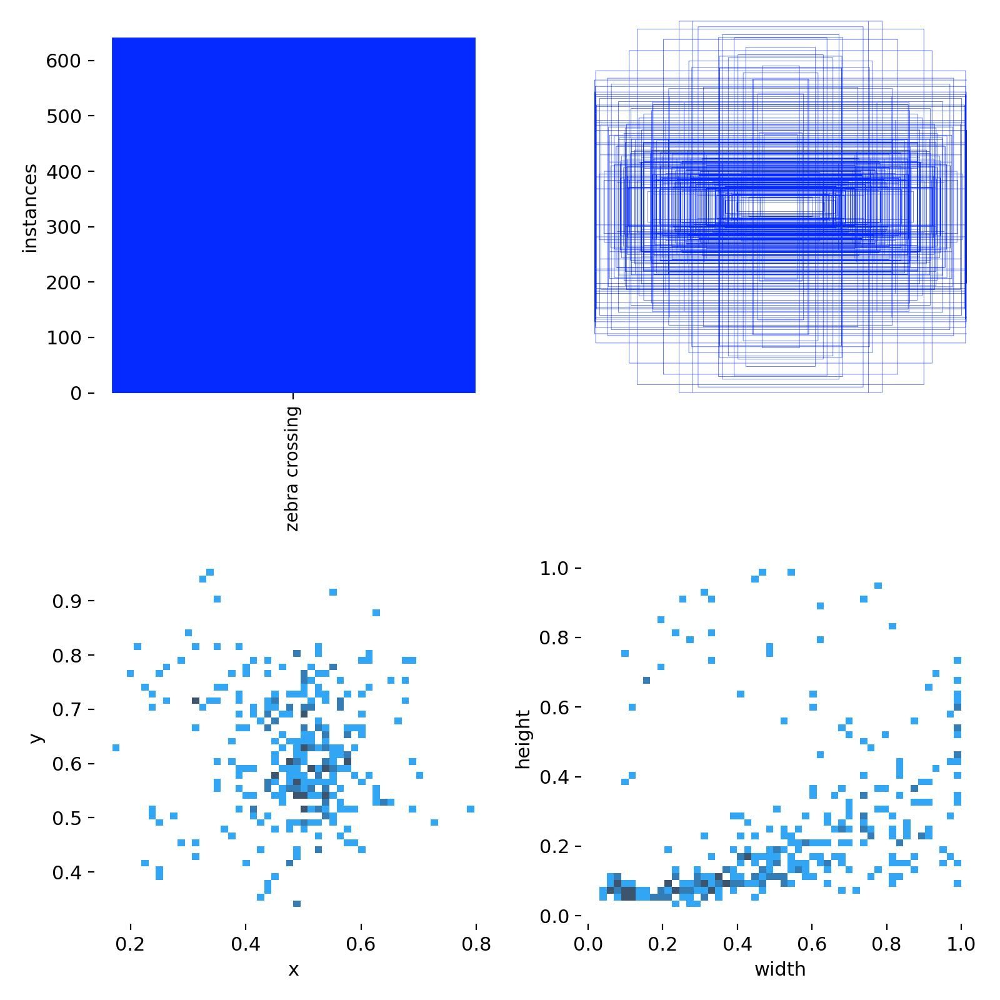

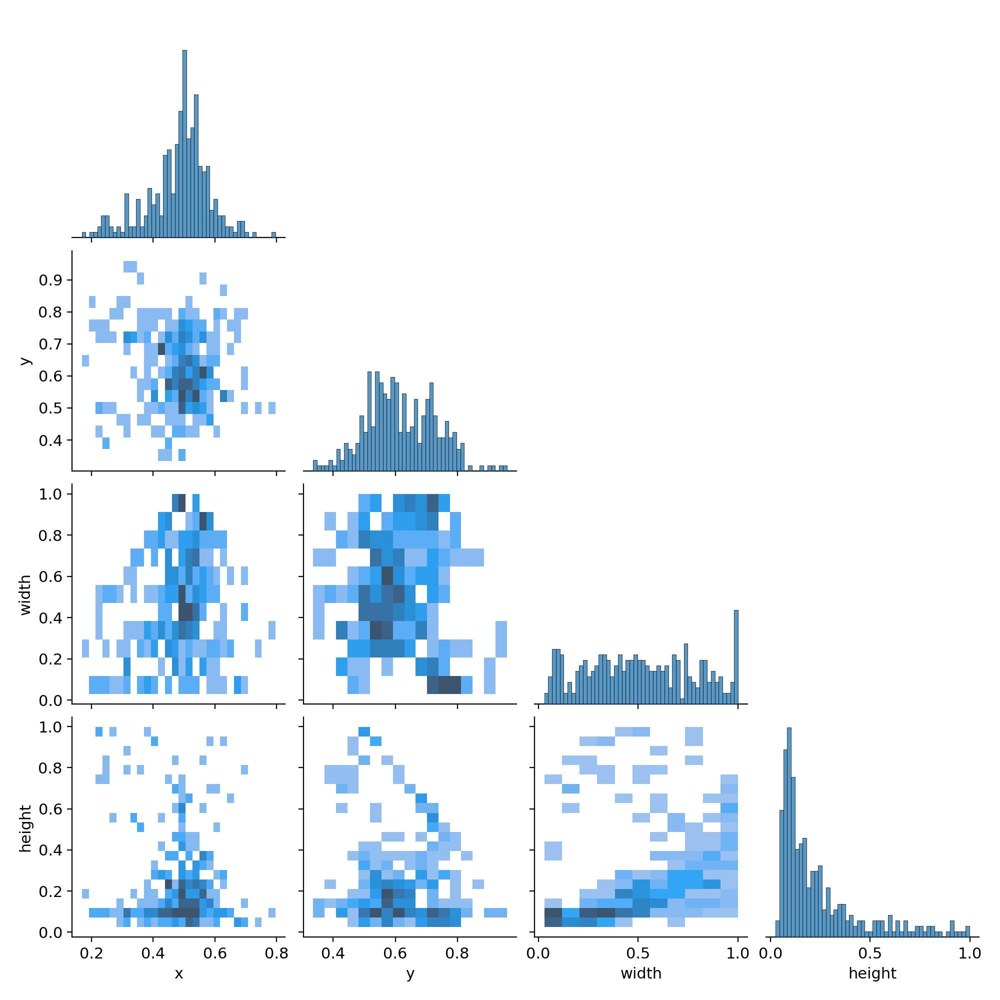

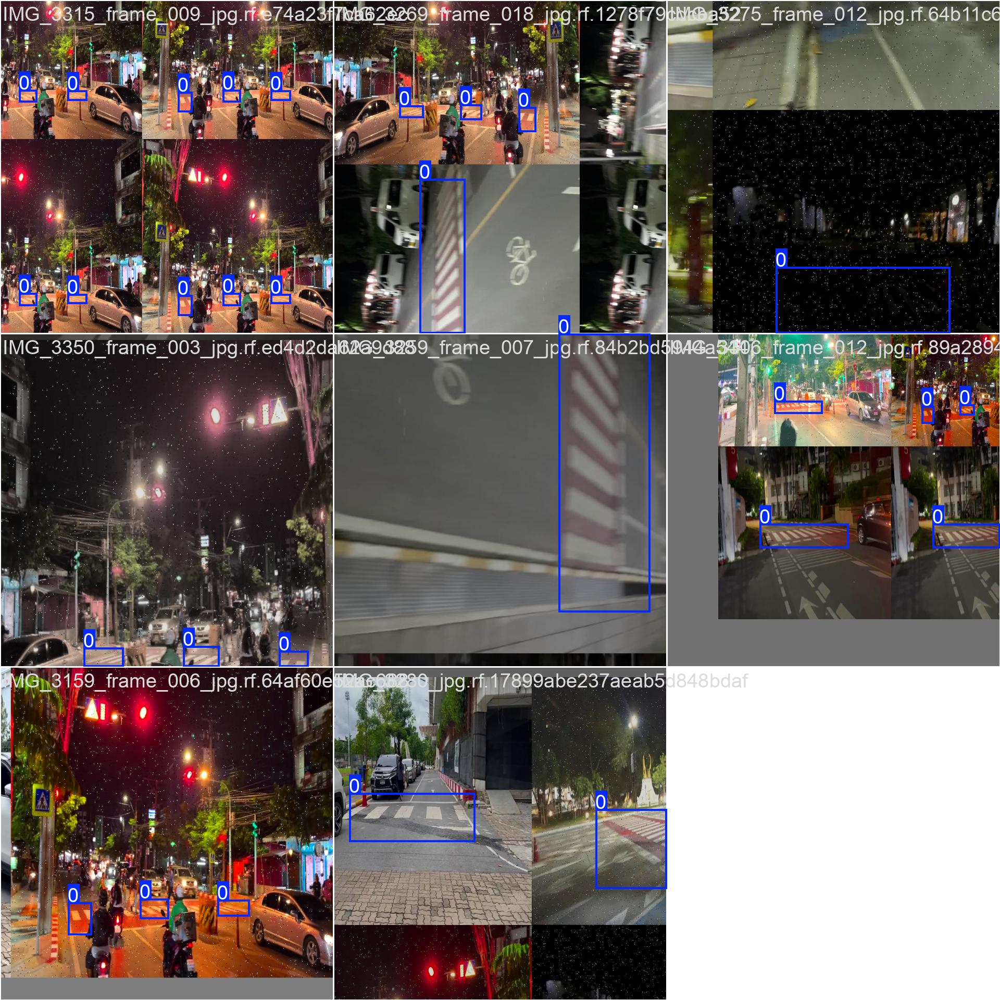

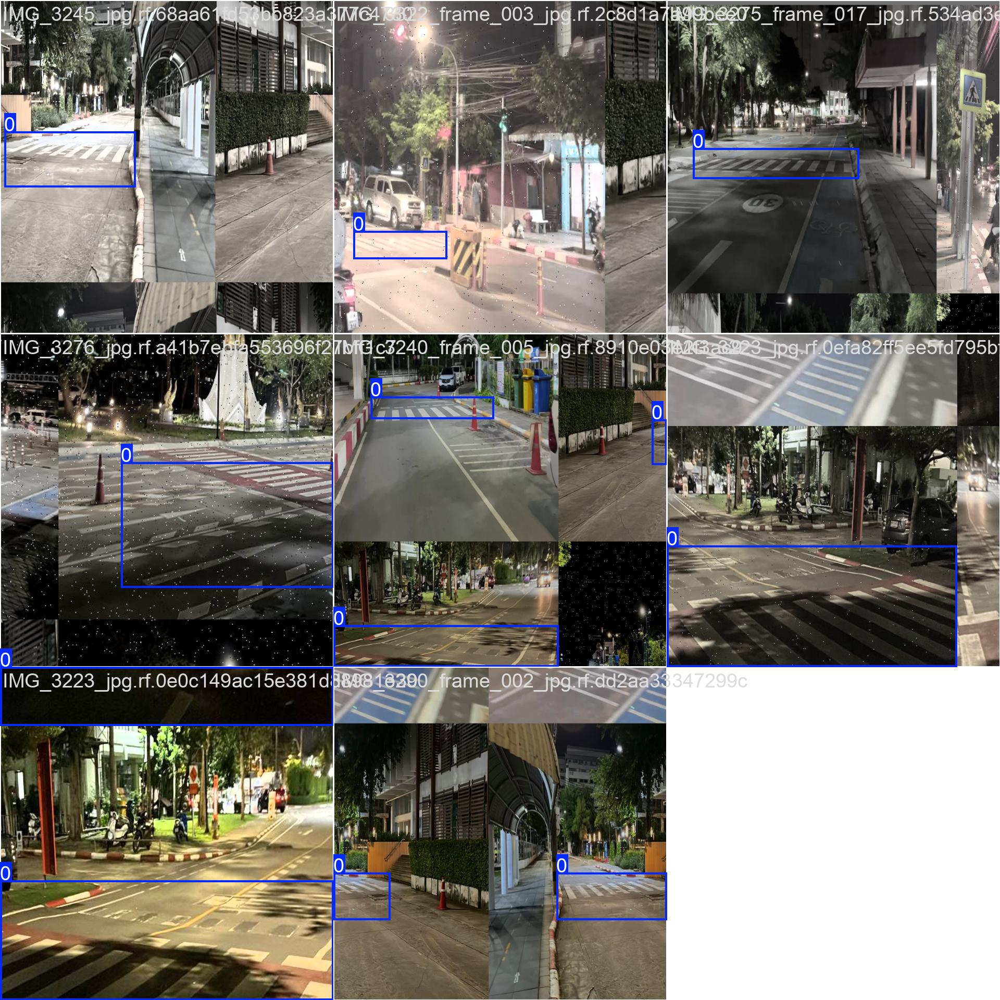

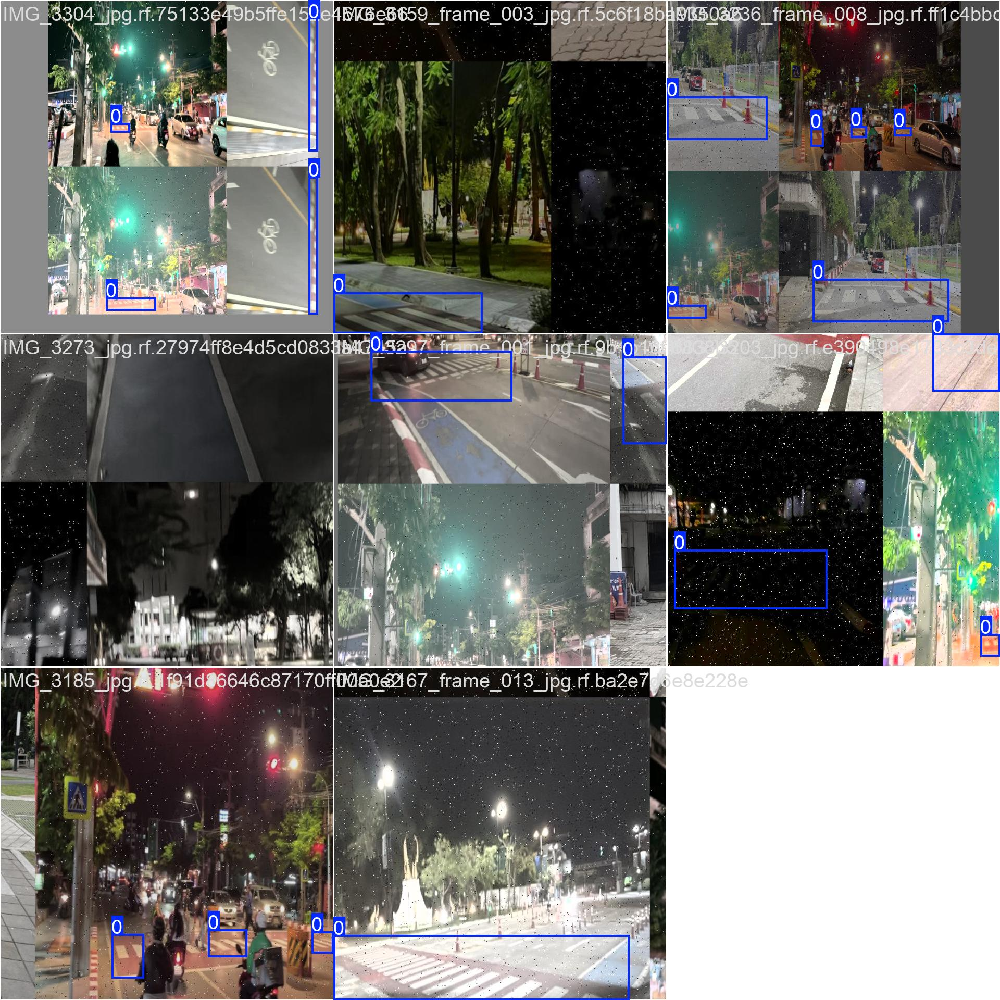

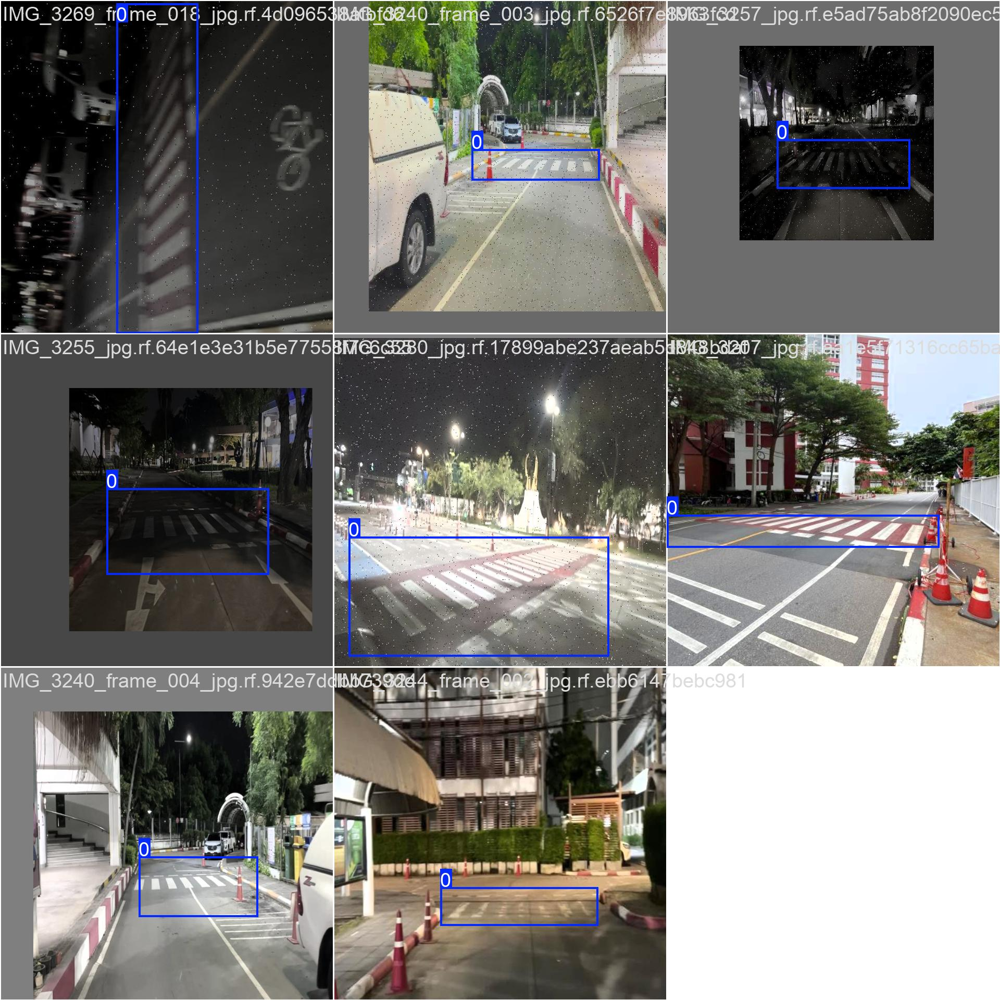

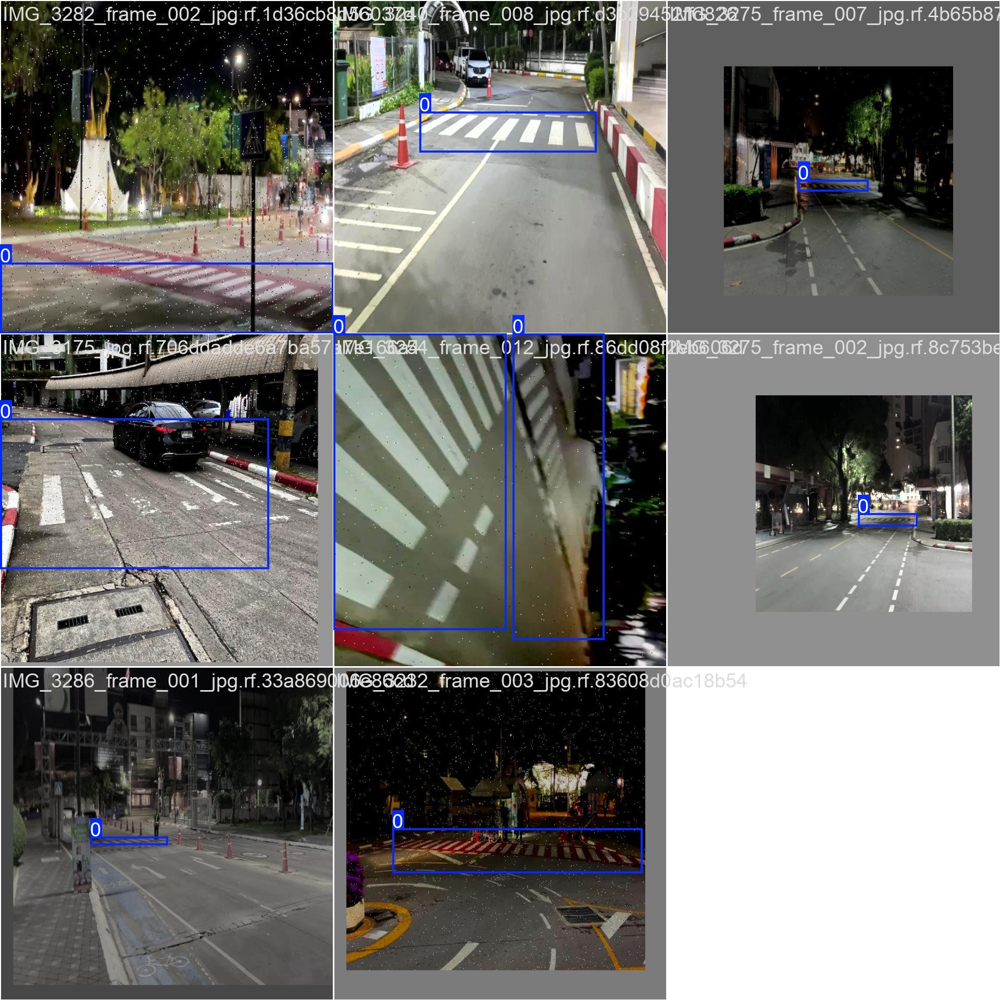

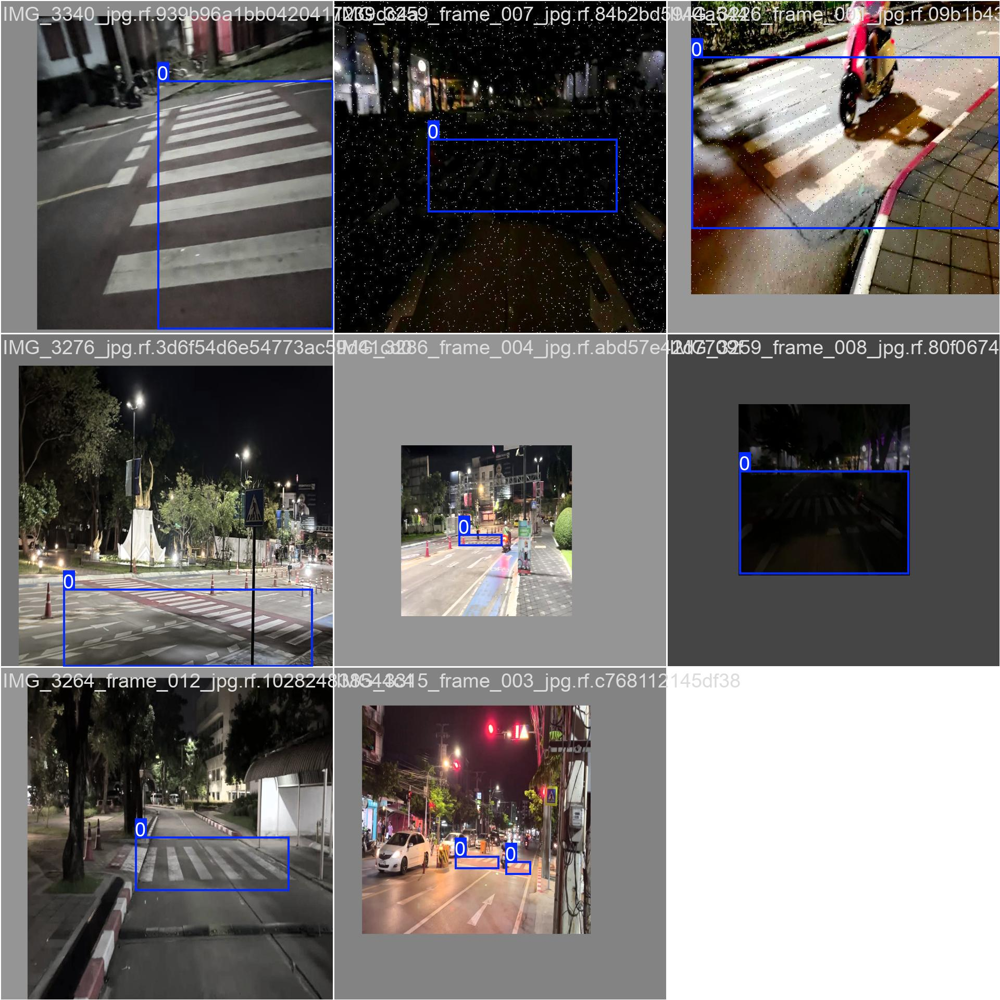

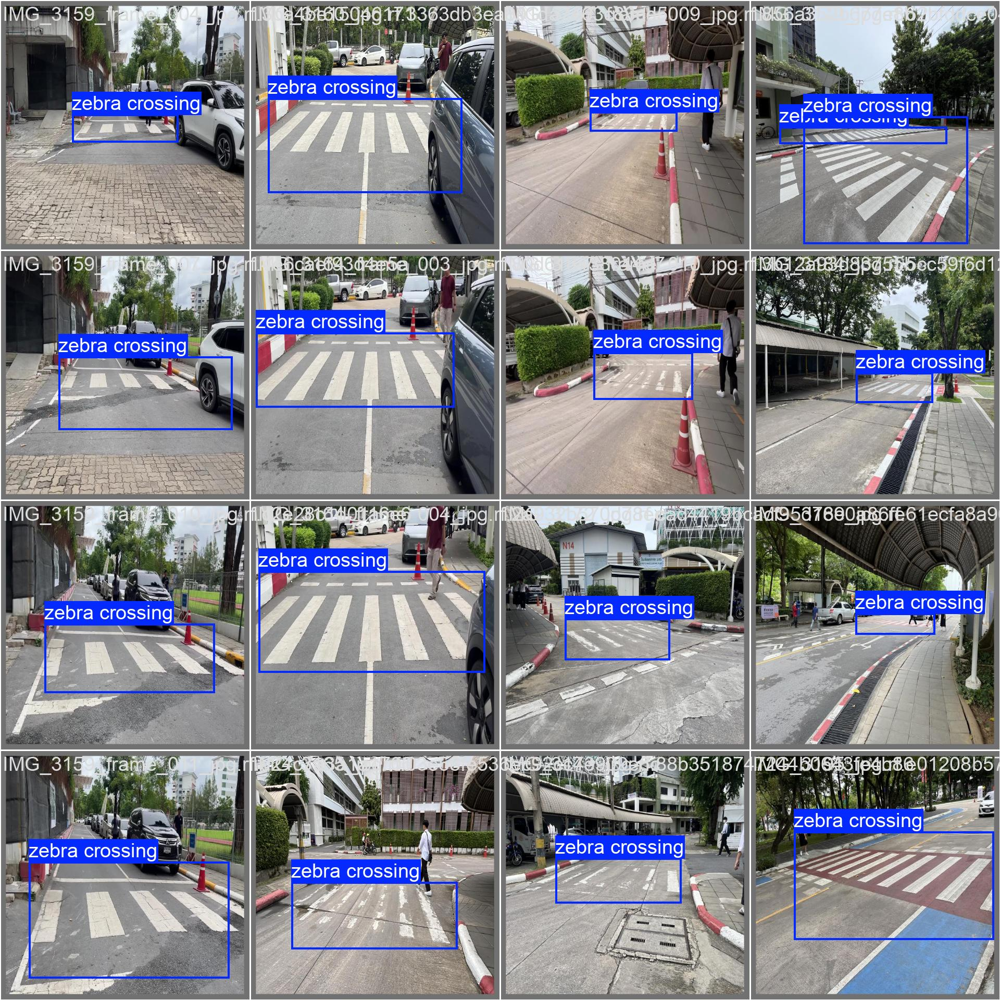

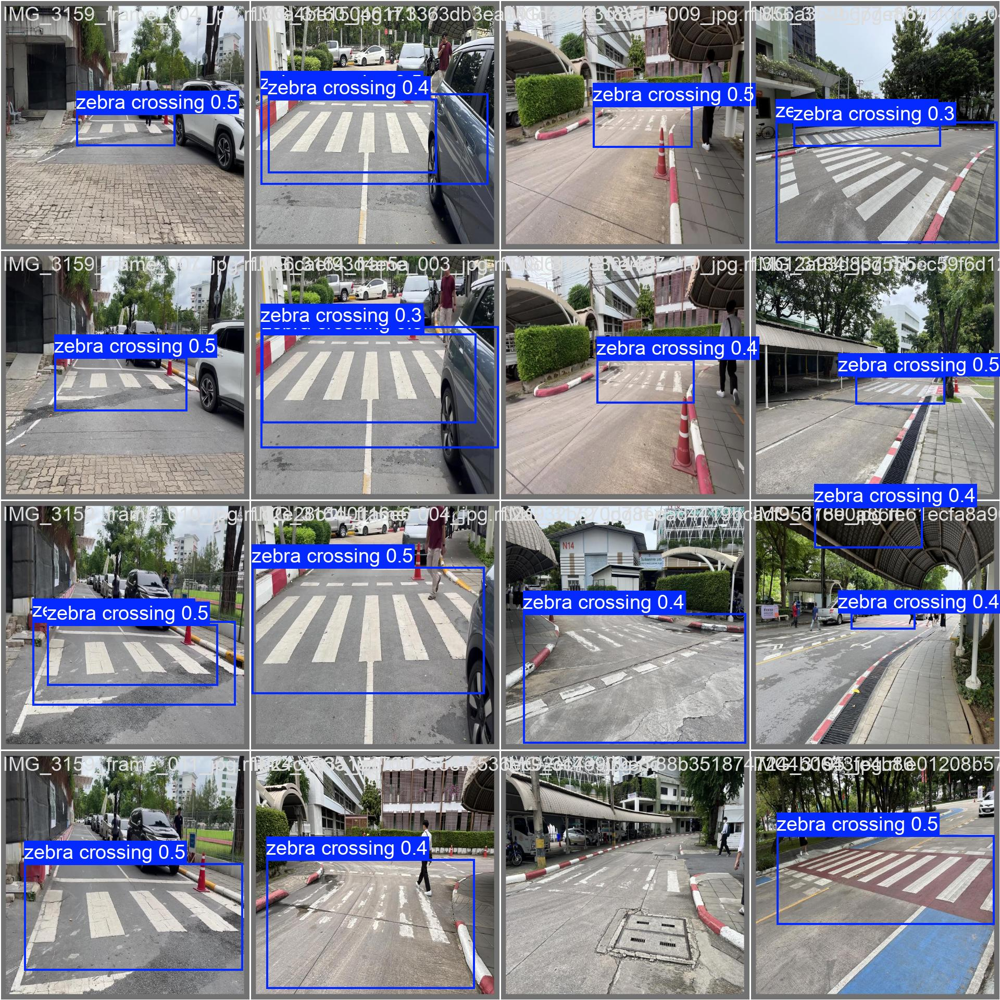

In [ ]:
from IPython.display import Image, display
import glob
for image_path in sorted(glob.glob('/content/runs/detect/zebra-crossing-detector-1/*.jpg'))[:10]:
  display(Image(filename=image_path))

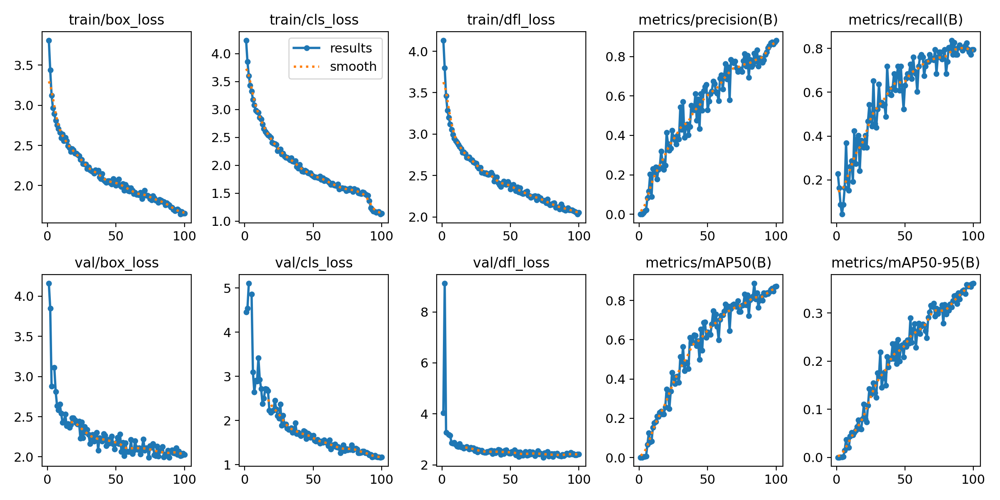

In [ ]:
from IPython.display import Image, display
display(Image(filename='/content/runs/detect/zebra-crossing-detector-1/results.png'))

In [ ]:
# ✅ Convert AVI to MP4 and Display Inline

import glob
import os
from IPython.display import HTML
from base64 import b64encode

# Step 1: Find the latest predict folder safely
predict_folders = sorted(glob.glob('/content/runs/detect/predict*'), key=os.path.getmtime)

if not predict_folders:
    print("⚠️ No predict folders found. Please run YOLO detection first.")
else:
    output_folder = predict_folders[-1]  # latest prediction folder
    print(f"✅ Latest prediction folder: {output_folder}")

    # Step 2: Find an AVI file inside that folder
    avi_files = glob.glob(os.path.join(output_folder, '*.avi'))
    if not avi_files:
        print("⚠️ No .avi video file found inside:", output_folder)
    else:
        avi_file = avi_files[0]
        mp4_output = os.path.join(output_folder, "annotated_video.mp4")

        # Step 3: Convert AVI to MP4
        !ffmpeg -y -i "{avi_file}" -c:v libx264 -pix_fmt yuv420p "{mp4_output}"

        # Step 4: Play the converted MP4 inline
        mp4_bytes = open(mp4_output, 'rb').read()
        data_url = "data:video/mp4;base64," + b64encode(mp4_bytes).decode()

        display(HTML(f'''
        <video width="640" controls>
            <source src="{data_url}" type="video/mp4">
        </video>
        '''))


✅ Latest prediction folder: /content/runs/detect/predict
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --en

In [ ]:
from google.colab import drive
import shutil
import os
import datetime

# 1️⃣ Mount Google Drive
drive.mount('/content/drive')

# 2️⃣ Set backup folder in Drive
backup_root = '/content/drive/MyDrive/YOLO_Backups'
os.makedirs(backup_root, exist_ok=True)

# 3️⃣ Timestamp for unique backup
timestamp = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')

# 4️⃣ Paths to backup
folders_to_backup = [
    '/content/runs/detect',   # YOLO outputs
    '/content/vehicle-1',     # your dataset folder (if needed)
]
notebook_file = '/content/your_notebook.ipynb'  # change this to your current notebook name

# 5️⃣ Copy folders
for folder in folders_to_backup:
    if os.path.exists(folder):
        dest = os.path.join(backup_root, f"{os.path.basename(folder)}_{timestamp}")
        shutil.copytree(folder, dest)
        print(f"Backed up folder {folder} → {dest}")

# 6️⃣ Copy notebook
if os.path.exists(notebook_file):
    notebook_dest = os.path.join(backup_root, f"{os.path.basename(notebook_file).replace('.ipynb','')}_{timestamp}.ipynb")
    shutil.copy(notebook_file, notebook_dest)
    print(f"Backed up notebook → {notebook_dest}")

print("✅ Backup completed!")